<a href="https://colab.research.google.com/github/maggiemcc02/Summer2023_Codes/blob/main/Adaptive_Mesh_Loop.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install FireDrake

In [ ]:
try:
  from firedrake import *
except ImportError:
  !wget "https://fem-on-colab.github.io/releases/firedrake-install-real.sh" -O "/tmp/firedrake-install.sh" && bash "/tmp/firedrake-install.sh"
  from firedrake import *

--2023-07-21 12:45:54--  https://fem-on-colab.github.io/releases/firedrake-install-real.sh
Resolving fem-on-colab.github.io (fem-on-colab.github.io)... 185.199.108.153, 185.199.109.153, 185.199.110.153, ...
Connecting to fem-on-colab.github.io (fem-on-colab.github.io)|185.199.108.153|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4468 (4.4K) [application/x-sh]
Saving to: ‘/tmp/firedrake-install.sh’

/tmp/firedrake-inst 100%[===================>]   4.36K  --.-KB/s    in 0s      

2023-07-21 12:45:54 (59.4 MB/s) - ‘/tmp/firedrake-install.sh’ saved [4468/4468]

+ INSTALL_PREFIX=/usr/local
++ echo /usr/local
++ awk -F/ '{print NF-1}'
+ INSTALL_PREFIX_DEPTH=2
+ PROJECT_NAME=fem-on-colab
+ SHARE_PREFIX=/usr/local/share/fem-on-colab
+ FIREDRAKE_INSTALLED=/usr/local/share/fem-on-colab/firedrake.installed
+ [[ ! -f /usr/local/share/fem-on-colab/firedrake.installed ]]
+ PYBIND11_INSTALL_SCRIPT_PATH=https://github.com/fem-on-colab/fem-on-colab.github.io/raw/dc3929a/rele

In [ ]:
from firedrake import *
import numpy as np
import matplotlib.pyplot as plt

# Create the Physical Solve Loop

In [ ]:


def MP_solver(num_points, iter, sigma):

  # set the initial mesh

  mesh = UnitSquareMesh(num_points, num_points)

  error_list = []



  for i in range(iter):


    ######################################
    # SOLVE THE PHYSICAL PROBLEM
    #######################################


    print()
    print()
    print('_'* 75)
    print('PHYSICAL SOLVE', i+1)
    print('_'* 75)
    print()
    print()


    # set the function space - a vector function space

    V = FunctionSpace(mesh, "CG", 1)

    # Access the Mesh Coordinates

    xi, eta = SpatialCoordinate(mesh) # mesh is \xi and \eta

    # set the test and and trial functions

    u  = TrialFunction(V)
    v = TestFunction(V)

    # set f

    f = Function(V)

    gauss = exp((-((xi - 1/2)**2 + (eta - 1/2)**2)) / (2 * (sigma)**2))

    f.interpolate( (-1/(sigma**2)) * gauss * ( 2 - (1/(sigma**2))*(xi - 1/2)**2  - (1/(sigma**2))*(eta - 1/2)**2 ))

    # define the problem

    a = - (inner( grad(u), grad(v) ) ) * dx # NEGATIVE

    L = ( inner( f, v ) ) * dx

    # define the BC's

    bcy1 = exp(-((0 - 1/2)**2 + (eta - 1/2)**2) / (2*sigma**2)) # x = 0
    bcy2 = exp(-((1 - 1/2)**2 + (eta - 1/2)**2) / (2*sigma**2)) # x = 1
    bcx1 = exp(-((xi - 1/2)**2 + (0 - 1/2)**2) / (2*sigma**2)) # y = 0
    bcx2 = exp(-((xi - 1/2)**2 + (1 - 1/2)**2) / (2*sigma**2)) # y = 1

    bc1 =  DirichletBC(V, bcy1 , 1)
    bc2 = DirichletBC(V, bcy2 , 2)
    bc3 = DirichletBC(V, bcx1 , 3)
    bc4 = DirichletBC(V, bcx2 , 4)

    bcs = [ bc1, bc2, bc3, bc4]

    # solve the problem

    u_sol = Function(V)

    solve(a == L, u_sol, bcs = bcs)

    # Colour Plot

    fig, axes = plt.subplots()
    colors = tripcolor(u_sol, axes = axes)
    plt.title('Solution Approximation ' + str(i+1) + " On a Mesh of " + str(val) + " Points")
    fig.colorbar(colors)
    plt.show()
    print()
    print()


    #################################################
    # Mesh Density Function
    #################################################


    # Compute the mesh density function

    grad_u = grad(u_sol)
    u_x = grad_u[0]
    u_y = grad_u[1]
    M = sqrt(1 + u_x**2 + u_y**2)



    #############################################
    # Solve the Mesh Problem
    #############################################


    print()
    print()
    print('~' * 35)
    print('MESH SOLVE ', i+1)
    print('~'*35)
    print()
    print()



    # # solve the mesh problem  - x


    # set the test and and trial functions

    x  = TrialFunction(V)
    v = TestFunction(V)

    # define the nonlinear problem

    a =  ( M *inner( grad(x), grad(v) ) )* dx

    L = ( Constant(0) * v  ) * dx

    # define the BC's

    bc1 =  DirichletBC(V, Constant(0), 1)
    bc2 = DirichletBC(V, Constant(1), 2)
    bc3 = DirichletBC(V, xi, 3)
    bc4 = DirichletBC(V, xi, 4)

    bcs = [ bc1, bc2, bc3, bc4]

    # solve

    x_sol = Function(V)

    solve(a == L, x_sol, bcs = bcs)


    # solve the mesh problem - y

    # set the test and and trial functions

    y  = TrialFunction(V)
    v = TestFunction(V)

    # define the nonlinear problem

    a = (M *inner( grad(y), grad(v) ) )* dx

    L = ( Constant(0) * v  ) * dx

    # define the BC's

    bc1 =  DirichletBC(V, eta, 1)
    bc2 = DirichletBC(V, eta, 2)
    bc3 = DirichletBC(V, Constant(0), 3)
    bc4 = DirichletBC(V, Constant(1), 4)

    bcs = [ bc1, bc2, bc3, bc4]

    # solve

    y_sol = Function(V)

    solve(a == L, y_sol, bcs = bcs)

    # Create and plot the new mesh

    N = np.shape(x_sol.dat.data)[0]
    mesh_values = np.zeros([N,2])
    mesh_values[:,0] = x_sol.dat.data
    mesh_values[:,1] = y_sol.dat.data
    mesh.coordinates.dat.data[:] = mesh_values
    fig, axes = plt.subplots()
    triplot(mesh, axes=axes)
    plt.title("Adapted Mesh for Solution " + str(i+1) + " On a Mesh of " + str(val) + " Points")
    plt.show()

    print()
    print()

    #################################################
    # Compute the error
    #################################################


    # compute the exact solution

    u_exact = Function(V).interpolate( exp((-((xi - 1/2)**2 + (eta - 1/2)**2)) / (2 * (sigma)**2)) )

    # compute and print the error

    # error = sqrt(assemble(dot(u_exact - u_sol, u_exact - u_sol) * dx))

    error = errornorm(u_exact, u_sol)

    error_list.append(error)

    print("Error for Solution", i+1, " is: ",  error)
    print()


  return error_list





___________________________________________________________________________
PHYSICAL SOLVE 1
___________________________________________________________________________




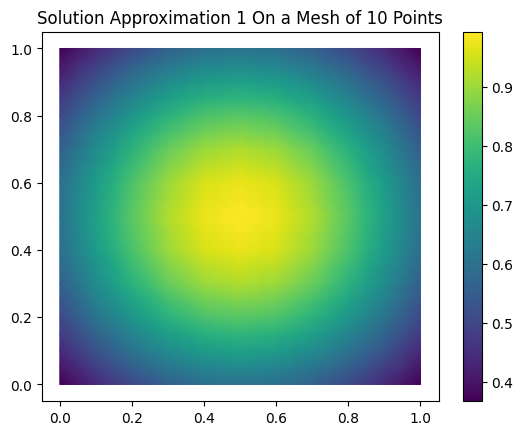





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




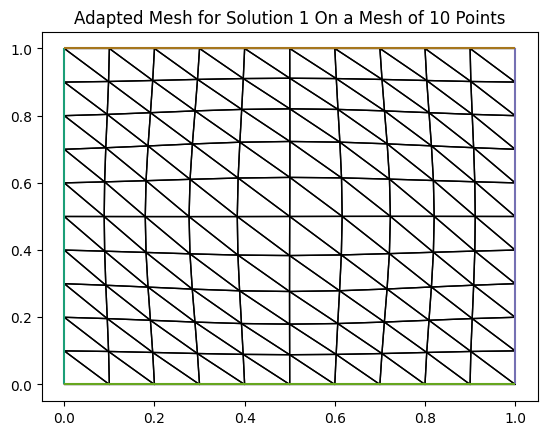



Error for Solution 1  is:  0.011083133034194632



___________________________________________________________________________
PHYSICAL SOLVE 2
___________________________________________________________________________




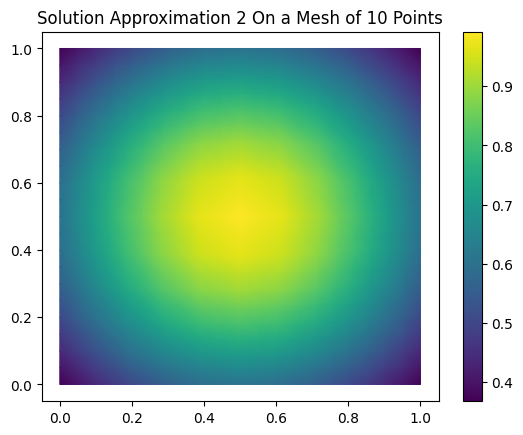





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  2
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




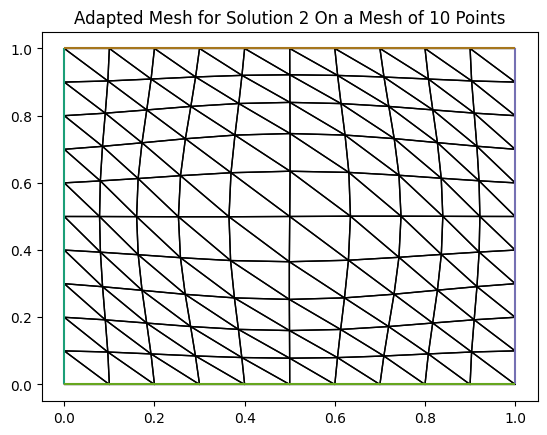



Error for Solution 2  is:  0.011070364587019604



___________________________________________________________________________
PHYSICAL SOLVE 3
___________________________________________________________________________




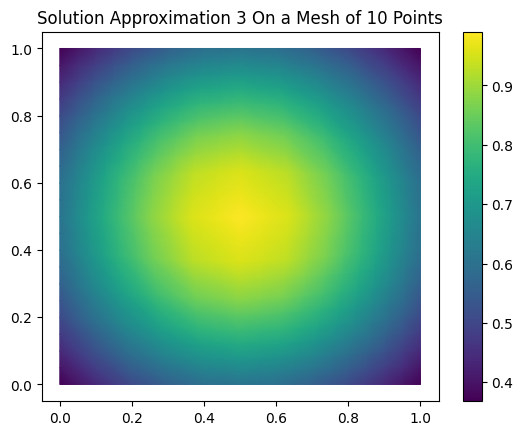





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  3
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




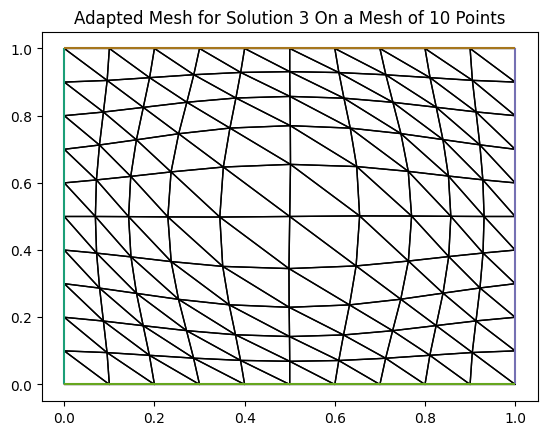



Error for Solution 3  is:  0.010990792561173888



___________________________________________________________________________
PHYSICAL SOLVE 4
___________________________________________________________________________




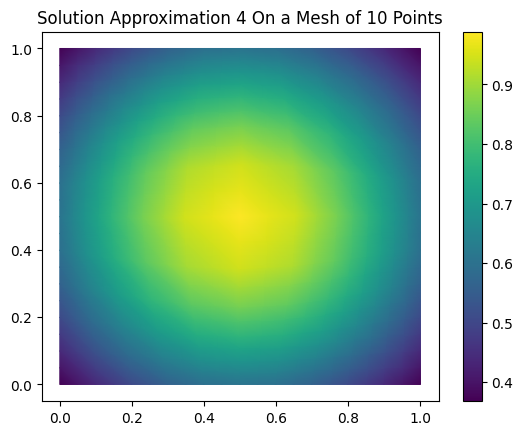





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  4
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




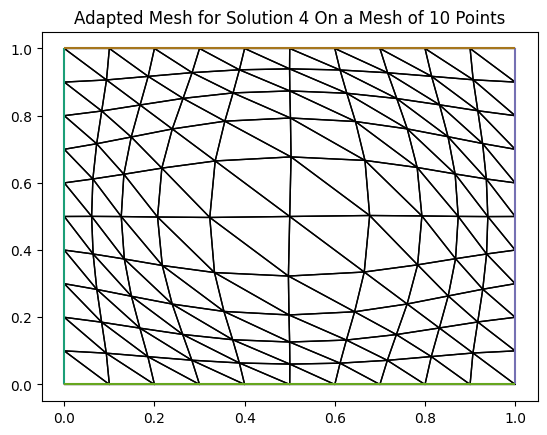



Error for Solution 4  is:  0.010850998028687914



___________________________________________________________________________
PHYSICAL SOLVE 5
___________________________________________________________________________




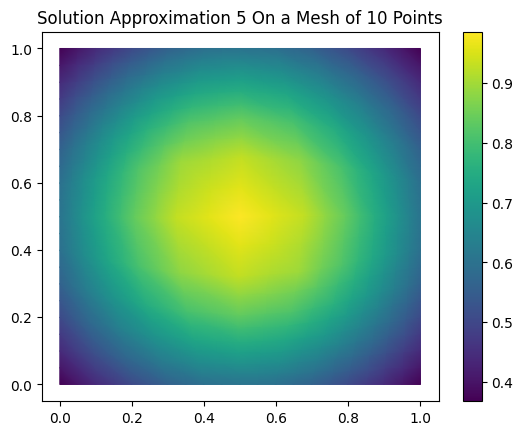





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  5
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




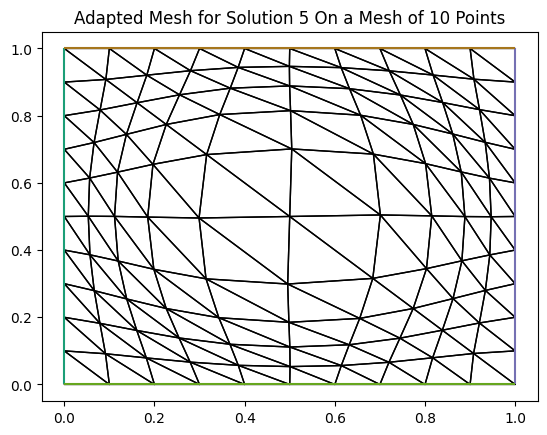



Error for Solution 5  is:  0.010658148162751699



___________________________________________________________________________
PHYSICAL SOLVE 6
___________________________________________________________________________




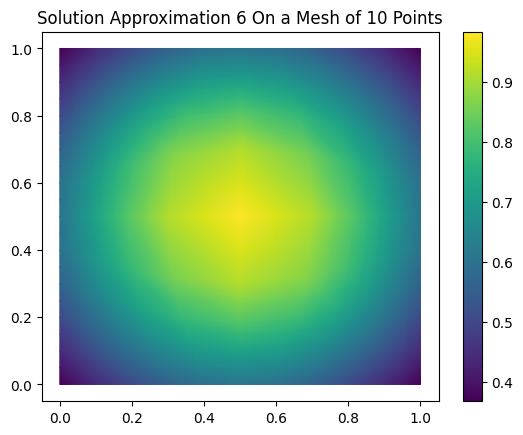





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  6
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




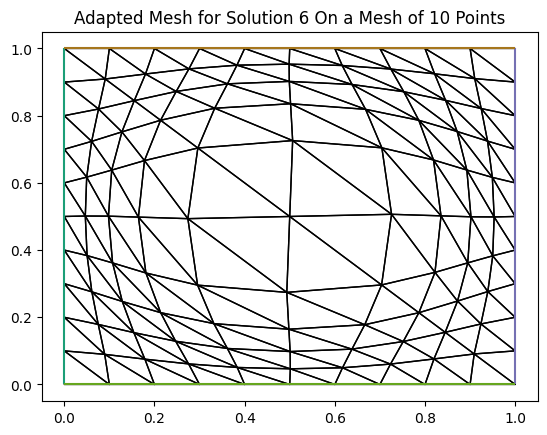



Error for Solution 6  is:  0.010420275358522435



___________________________________________________________________________
PHYSICAL SOLVE 7
___________________________________________________________________________




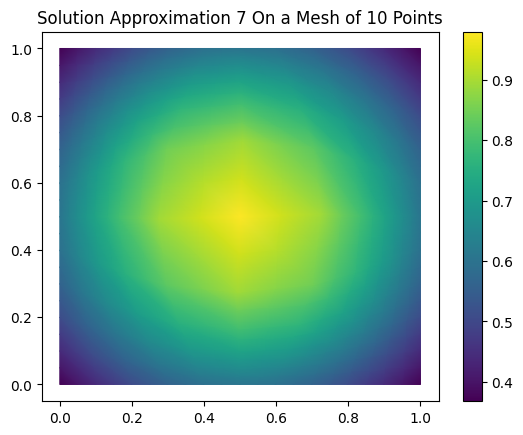





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  7
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




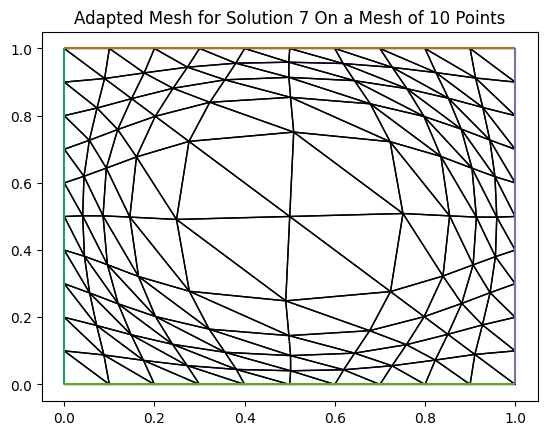



Error for Solution 7  is:  0.010158283405436853



___________________________________________________________________________
PHYSICAL SOLVE 8
___________________________________________________________________________




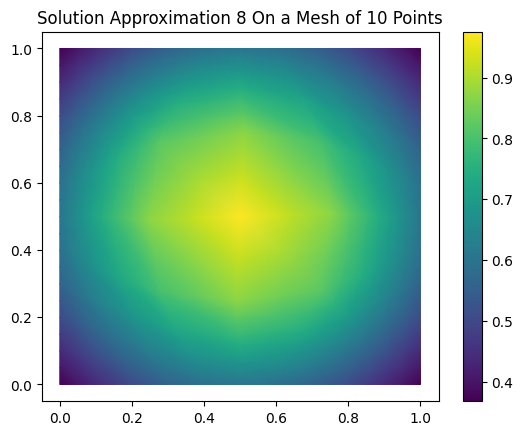





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  8
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




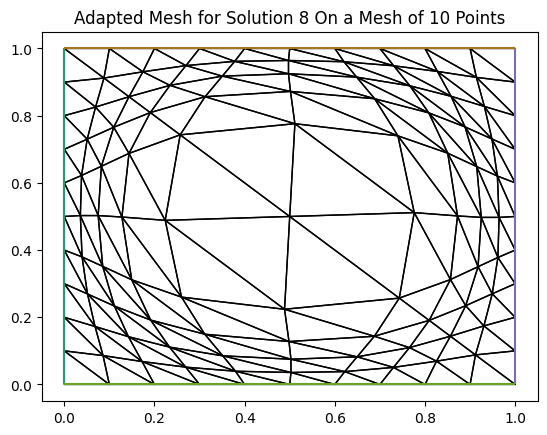



Error for Solution 8  is:  0.009932898013141742



___________________________________________________________________________
PHYSICAL SOLVE 9
___________________________________________________________________________




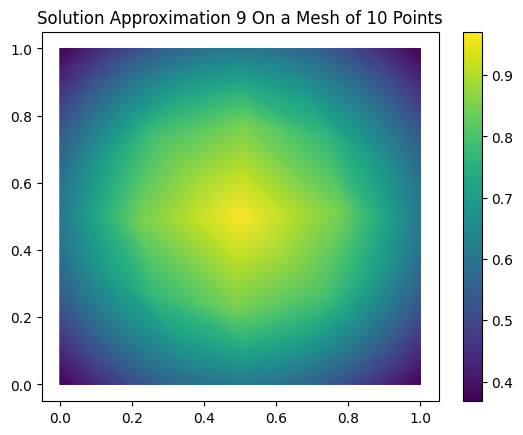





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  9
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




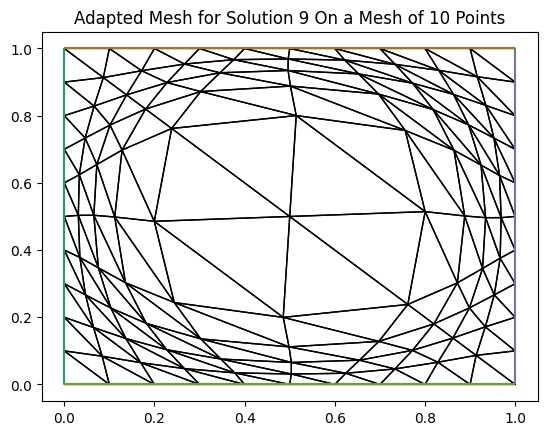



Error for Solution 9  is:  0.009863287792073417



___________________________________________________________________________
PHYSICAL SOLVE 10
___________________________________________________________________________




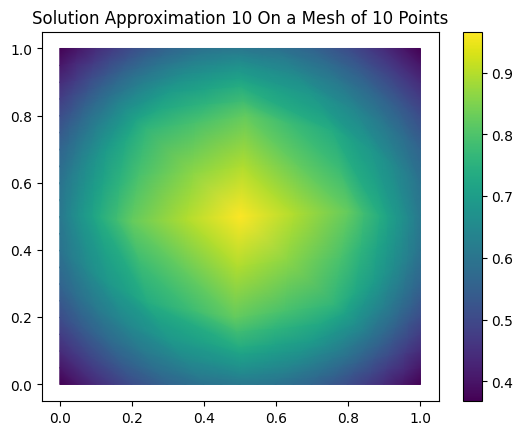





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  10
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




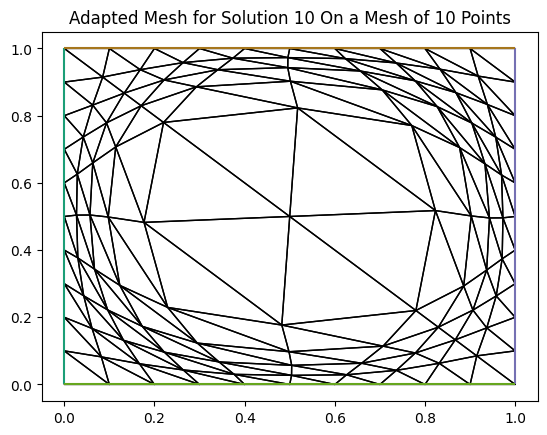



Error for Solution 10  is:  0.010094387269688395



___________________________________________________________________________
PHYSICAL SOLVE 1
___________________________________________________________________________




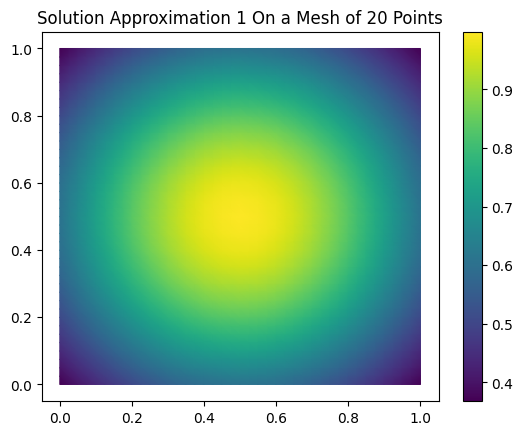





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




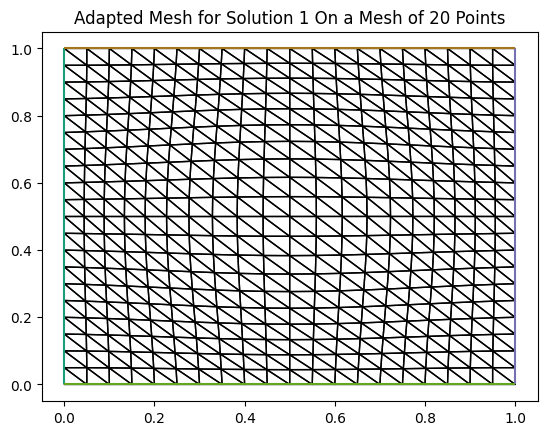



Error for Solution 1  is:  0.013429250175596928



___________________________________________________________________________
PHYSICAL SOLVE 2
___________________________________________________________________________




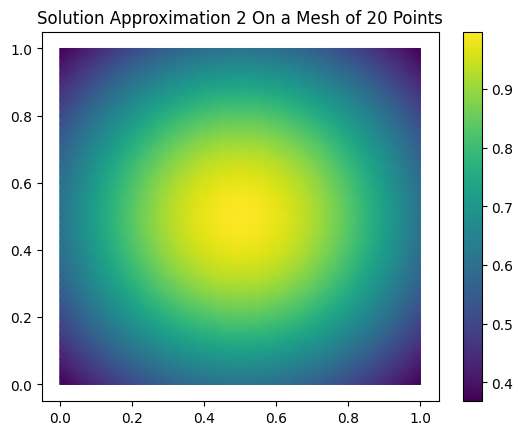





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  2
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




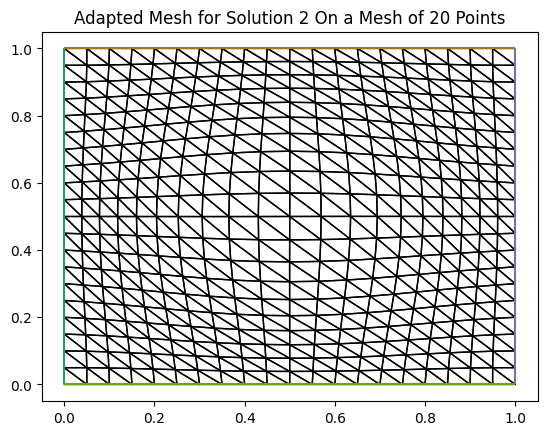



Error for Solution 2  is:  0.013423580726504587



___________________________________________________________________________
PHYSICAL SOLVE 3
___________________________________________________________________________




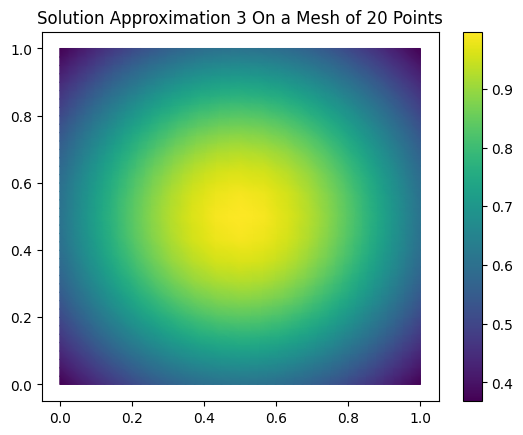





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  3
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




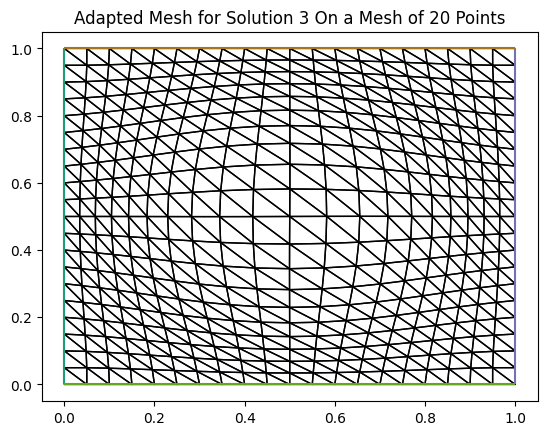



Error for Solution 3  is:  0.013392309523228552



___________________________________________________________________________
PHYSICAL SOLVE 4
___________________________________________________________________________




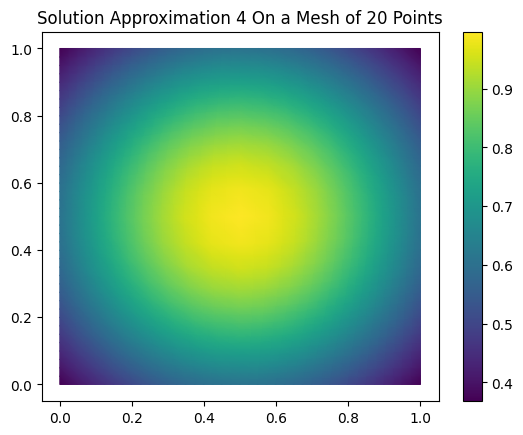





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  4
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




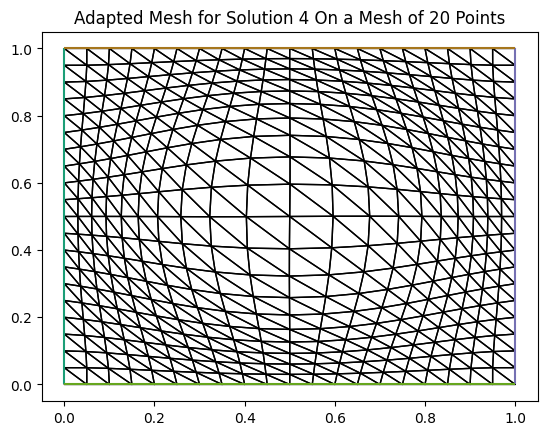



Error for Solution 4  is:  0.0133328204334472



___________________________________________________________________________
PHYSICAL SOLVE 5
___________________________________________________________________________




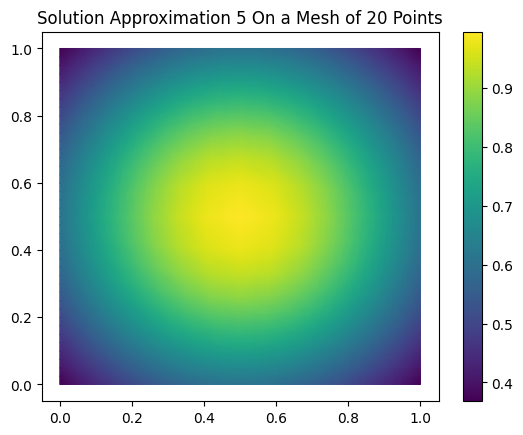





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  5
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




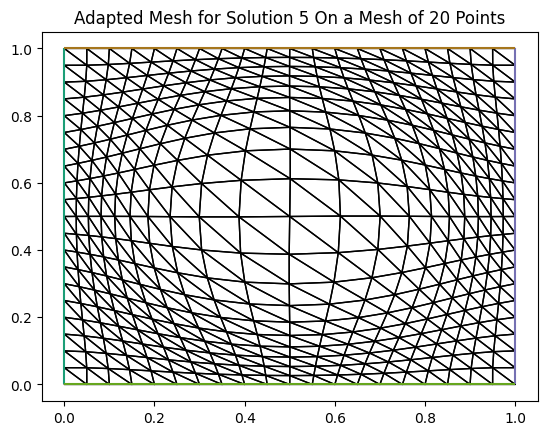



Error for Solution 5  is:  0.013239806283012873



___________________________________________________________________________
PHYSICAL SOLVE 6
___________________________________________________________________________




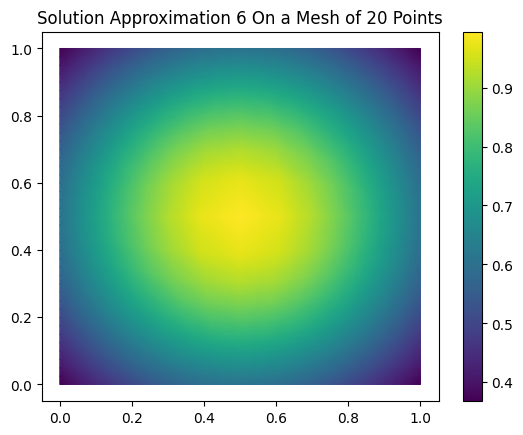





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  6
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




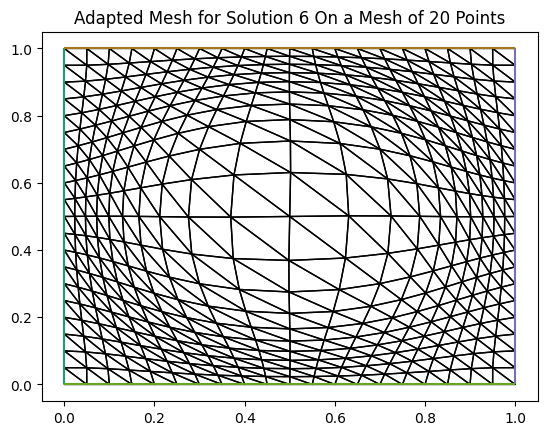



Error for Solution 6  is:  0.013105931298187257



___________________________________________________________________________
PHYSICAL SOLVE 7
___________________________________________________________________________




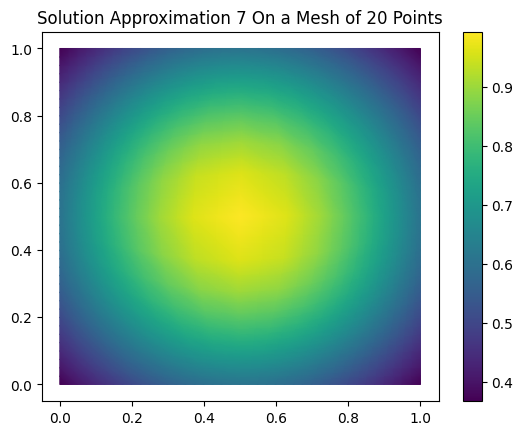





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  7
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




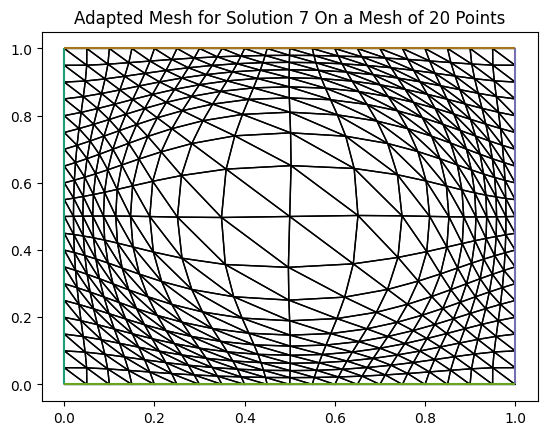



Error for Solution 7  is:  0.012922856069267179



___________________________________________________________________________
PHYSICAL SOLVE 8
___________________________________________________________________________




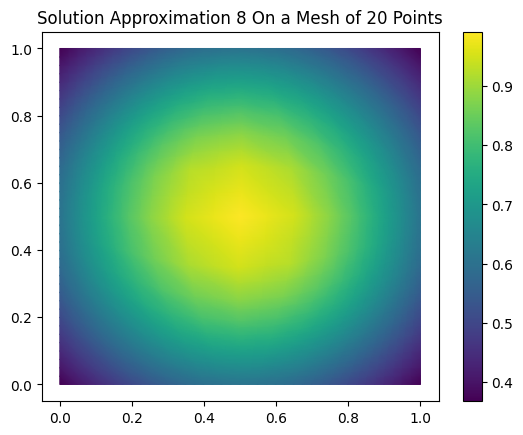





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  8
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




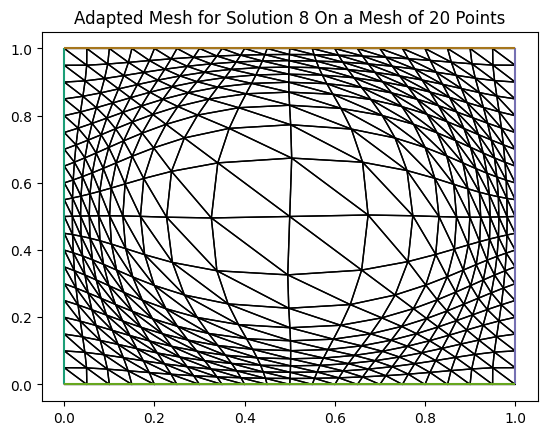



Error for Solution 8  is:  0.012681603033536253



___________________________________________________________________________
PHYSICAL SOLVE 9
___________________________________________________________________________




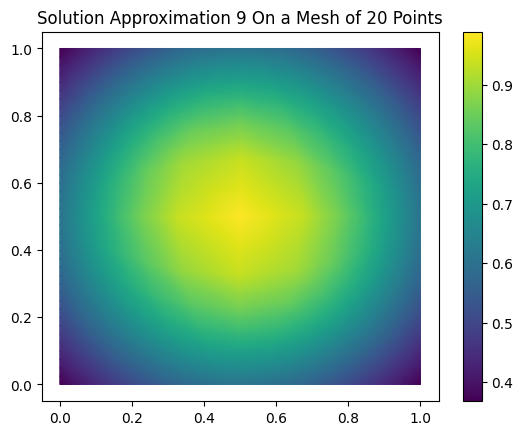





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  9
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




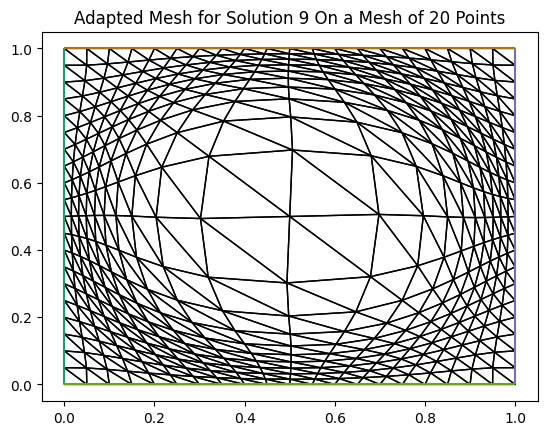



Error for Solution 9  is:  0.012371742834275817



___________________________________________________________________________
PHYSICAL SOLVE 10
___________________________________________________________________________




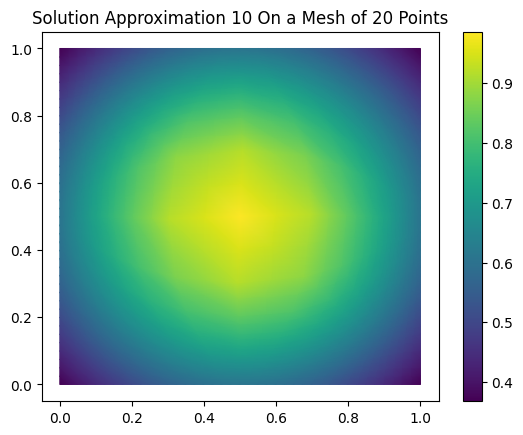





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  10
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




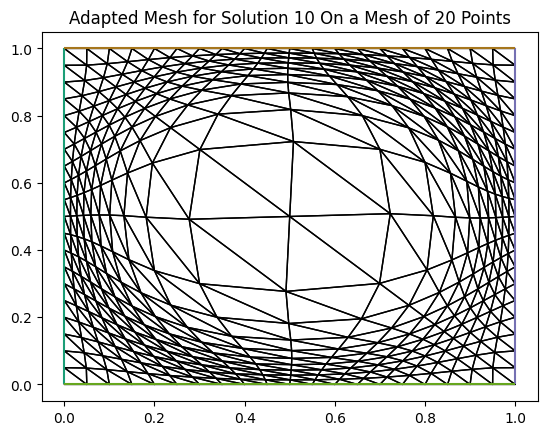



Error for Solution 10  is:  0.011984118020972883



___________________________________________________________________________
PHYSICAL SOLVE 1
___________________________________________________________________________




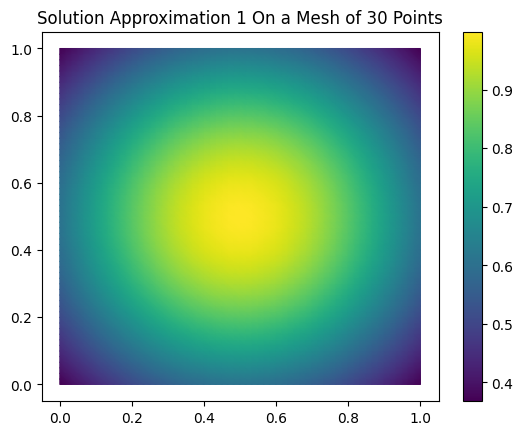





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




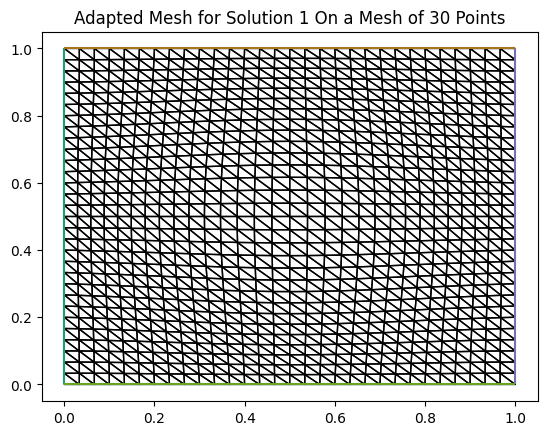



Error for Solution 1  is:  0.013886549594244459



___________________________________________________________________________
PHYSICAL SOLVE 2
___________________________________________________________________________




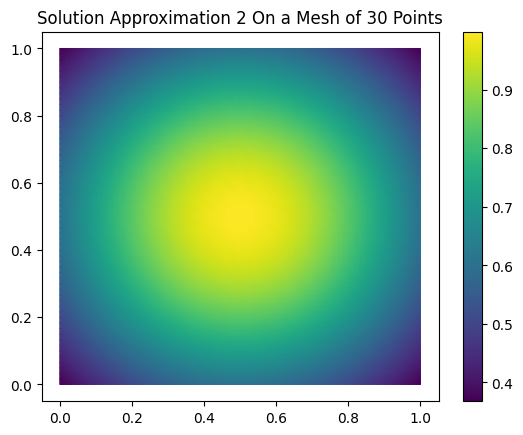





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  2
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




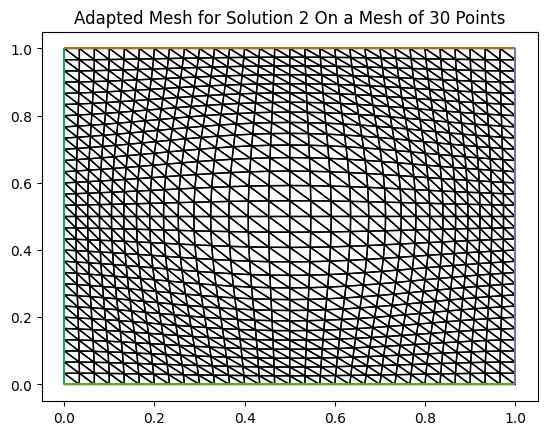



Error for Solution 2  is:  0.013883861469885206



___________________________________________________________________________
PHYSICAL SOLVE 3
___________________________________________________________________________




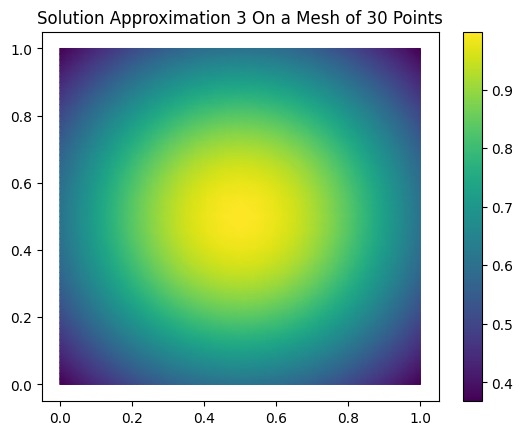





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  3
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




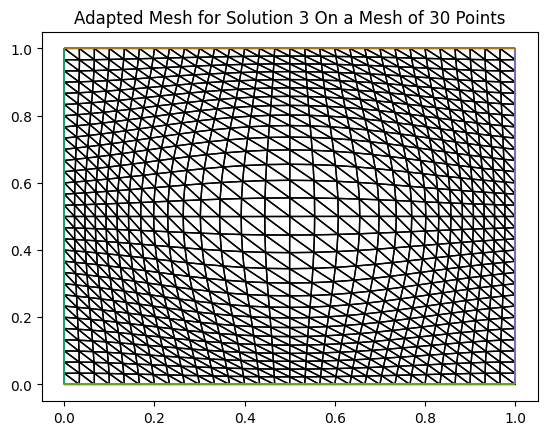



Error for Solution 3  is:  0.013869029051458015



___________________________________________________________________________
PHYSICAL SOLVE 4
___________________________________________________________________________




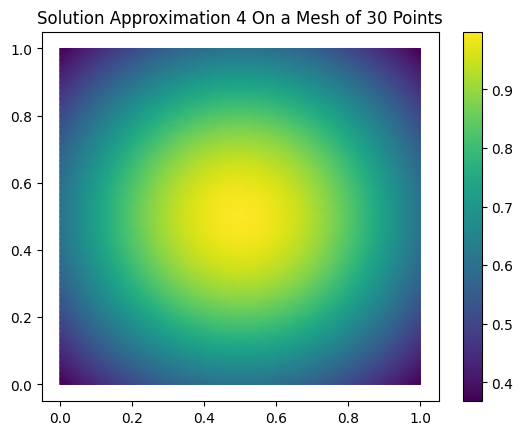





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  4
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




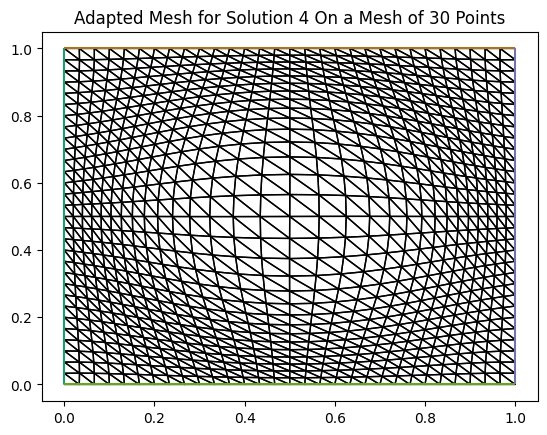



Error for Solution 4  is:  0.013840494497547956



___________________________________________________________________________
PHYSICAL SOLVE 5
___________________________________________________________________________




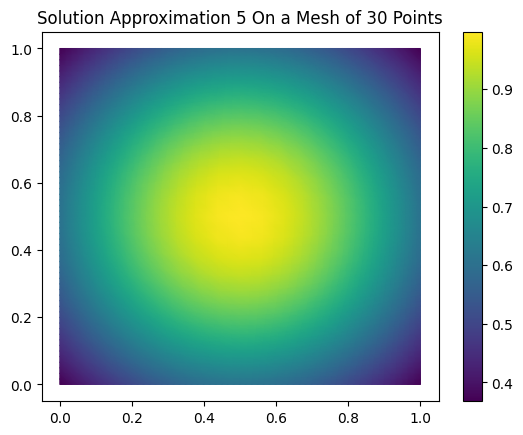





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  5
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




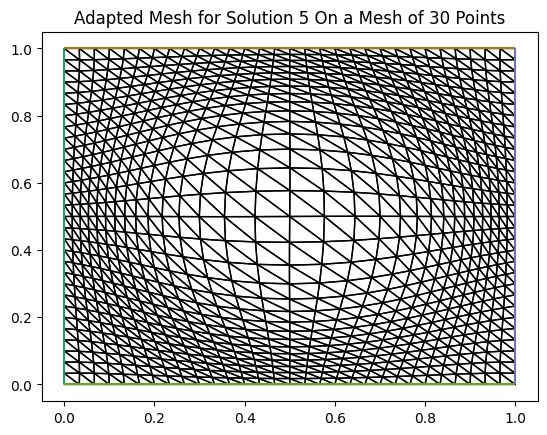



Error for Solution 5  is:  0.013794921066286558



___________________________________________________________________________
PHYSICAL SOLVE 6
___________________________________________________________________________




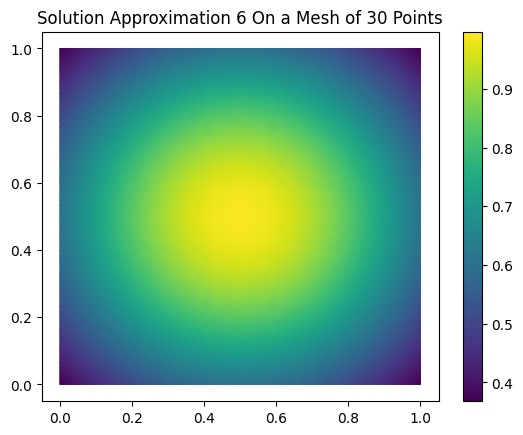





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  6
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




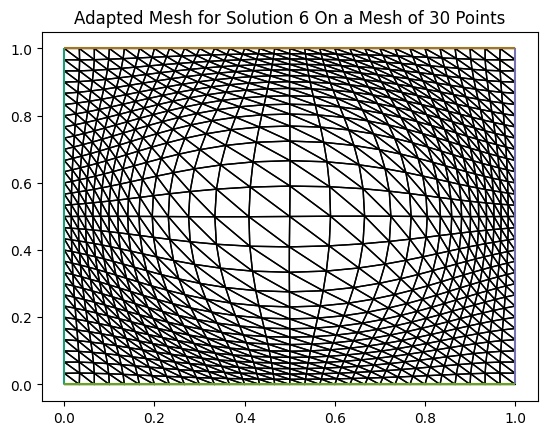



Error for Solution 6  is:  0.013727055762647126



___________________________________________________________________________
PHYSICAL SOLVE 7
___________________________________________________________________________




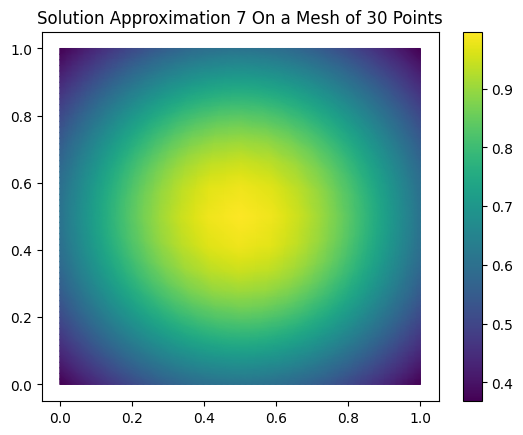





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  7
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




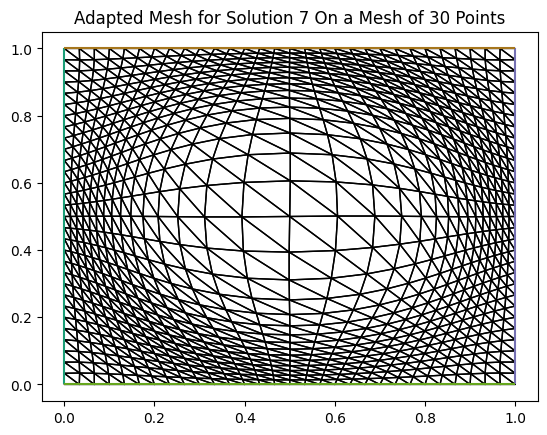



Error for Solution 7  is:  0.013629653247198089



___________________________________________________________________________
PHYSICAL SOLVE 8
___________________________________________________________________________




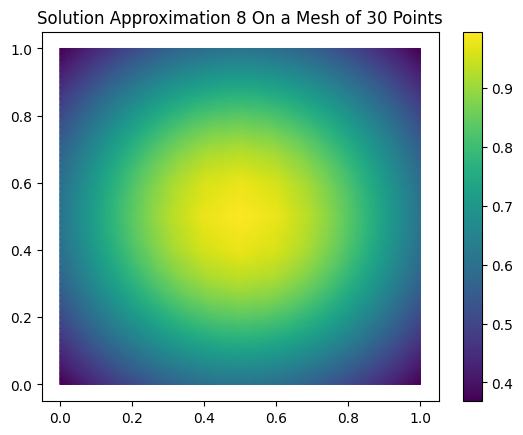





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  8
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




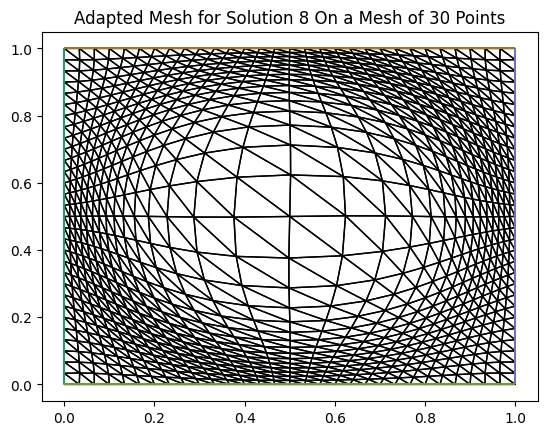



Error for Solution 8  is:  0.013493712361784272



___________________________________________________________________________
PHYSICAL SOLVE 9
___________________________________________________________________________




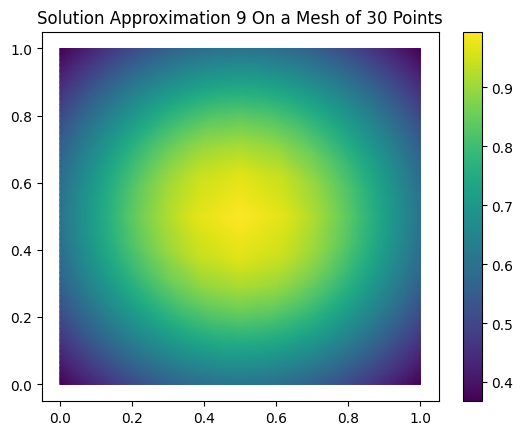





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  9
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




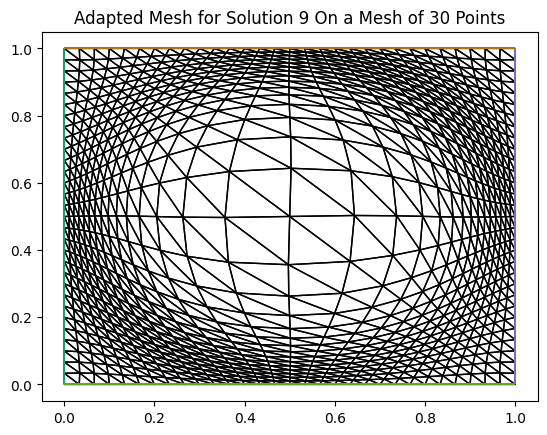



Error for Solution 9  is:  0.013309149015416764



___________________________________________________________________________
PHYSICAL SOLVE 10
___________________________________________________________________________




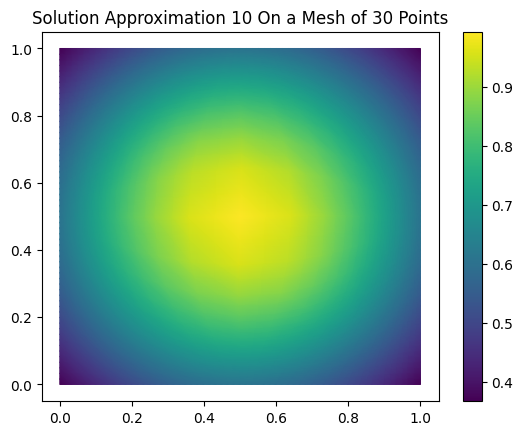





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  10
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




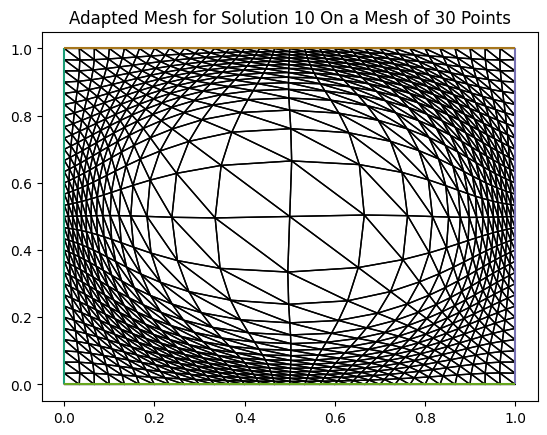



Error for Solution 10  is:  0.013065280137928348



___________________________________________________________________________
PHYSICAL SOLVE 1
___________________________________________________________________________




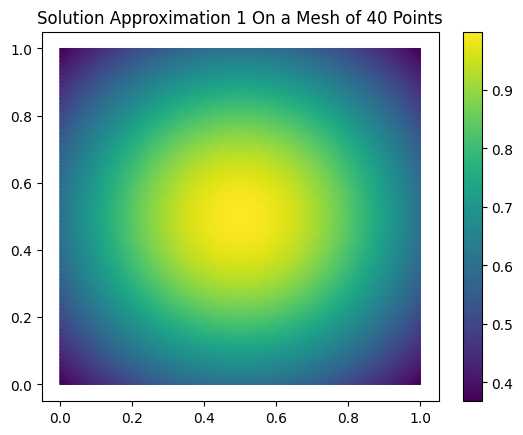





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




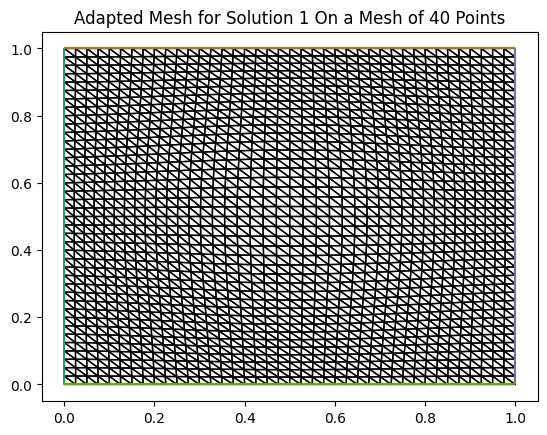



Error for Solution 1  is:  0.01404821664526973



___________________________________________________________________________
PHYSICAL SOLVE 2
___________________________________________________________________________




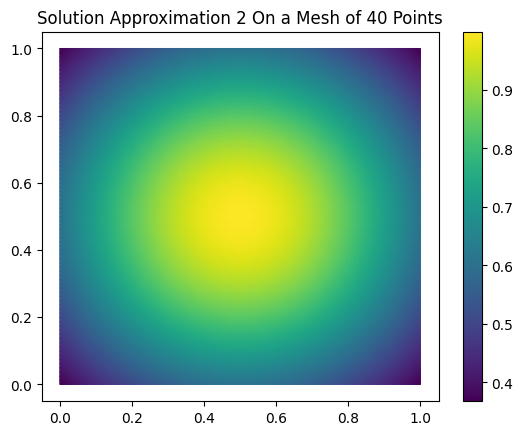





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  2
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




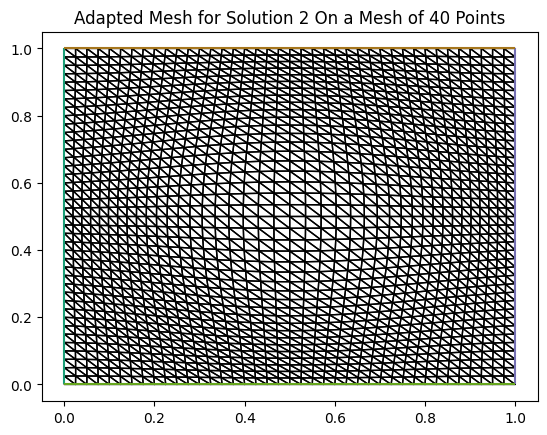



Error for Solution 2  is:  0.014046672111723895



___________________________________________________________________________
PHYSICAL SOLVE 3
___________________________________________________________________________




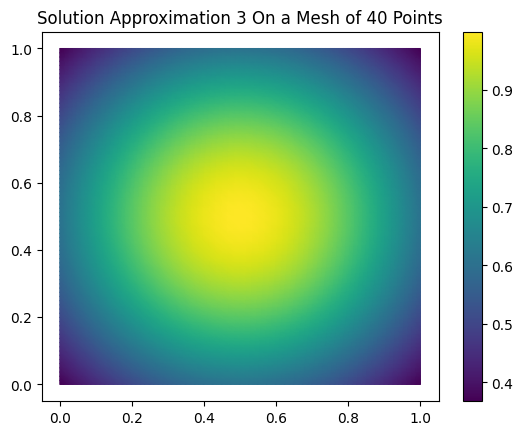





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  3
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




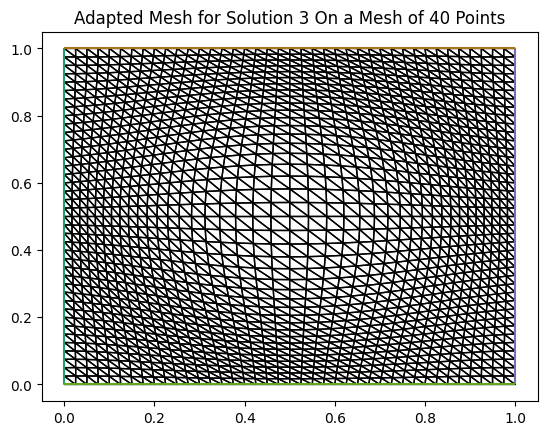



Error for Solution 3  is:  0.01403814178770944



___________________________________________________________________________
PHYSICAL SOLVE 4
___________________________________________________________________________




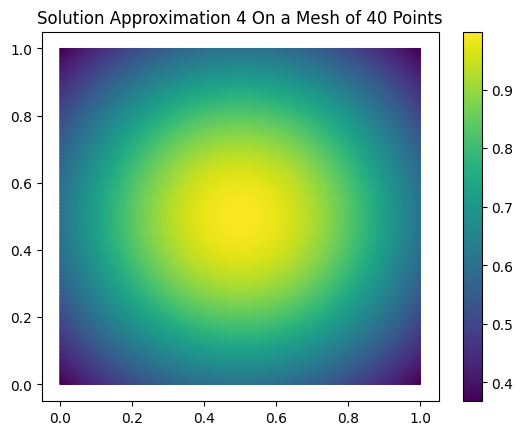





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  4
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




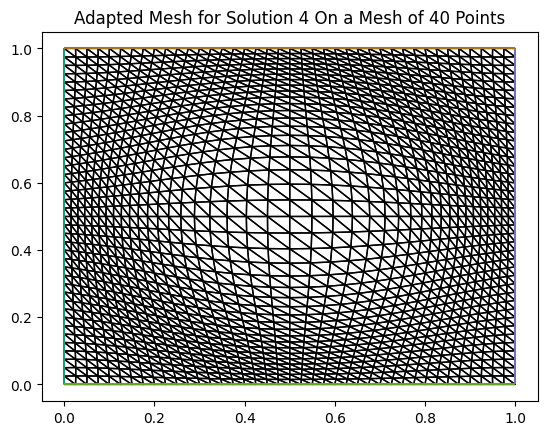



Error for Solution 4  is:  0.014021666139503957



___________________________________________________________________________
PHYSICAL SOLVE 5
___________________________________________________________________________




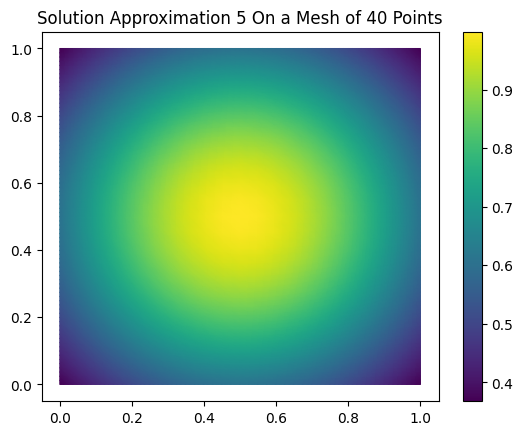





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  5
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




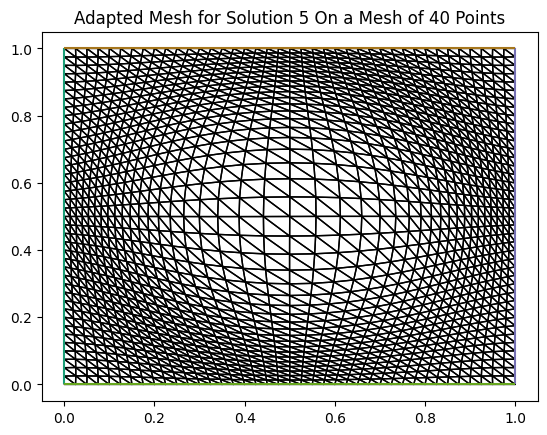



Error for Solution 5  is:  0.013995159656920485



___________________________________________________________________________
PHYSICAL SOLVE 6
___________________________________________________________________________




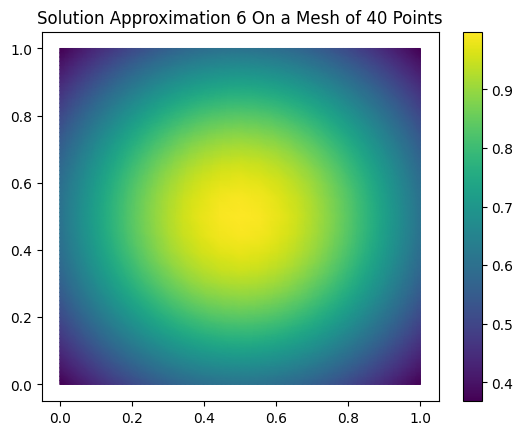





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  6
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




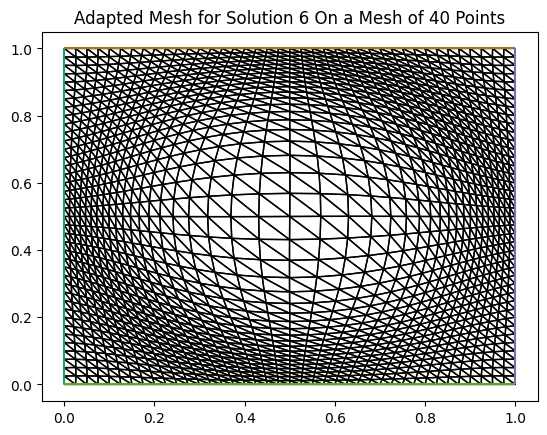



Error for Solution 6  is:  0.013955236053174232



___________________________________________________________________________
PHYSICAL SOLVE 7
___________________________________________________________________________




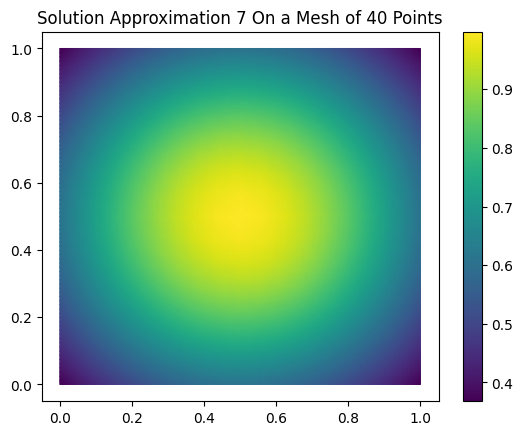





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  7
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




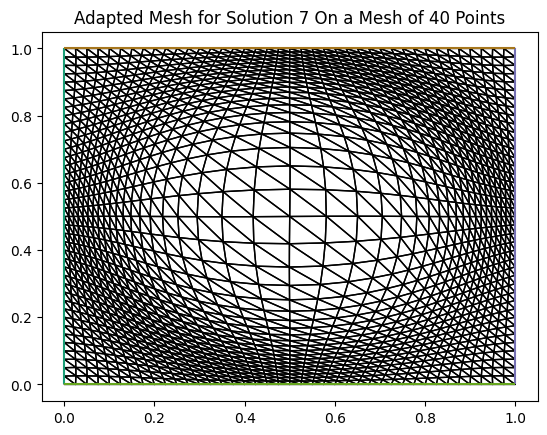



Error for Solution 7  is:  0.013896966308438816



___________________________________________________________________________
PHYSICAL SOLVE 8
___________________________________________________________________________




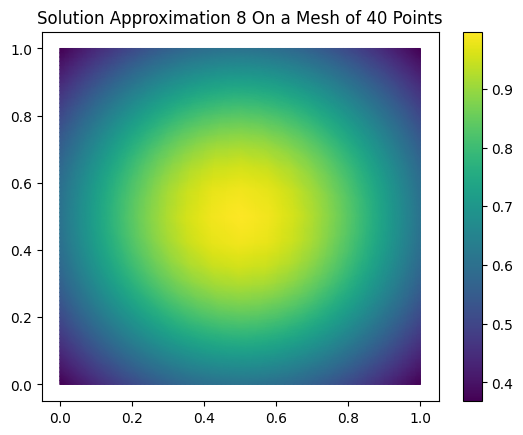





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  8
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




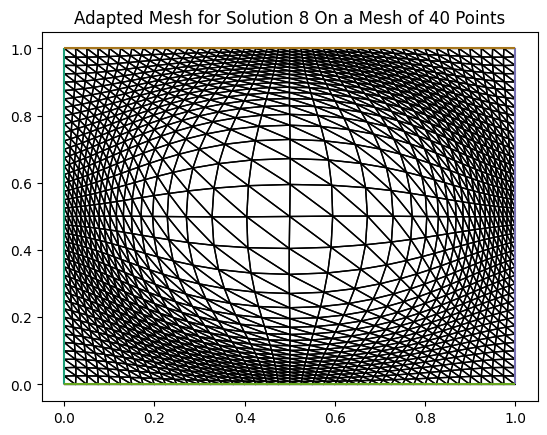



Error for Solution 8  is:  0.013813646714321606



___________________________________________________________________________
PHYSICAL SOLVE 9
___________________________________________________________________________




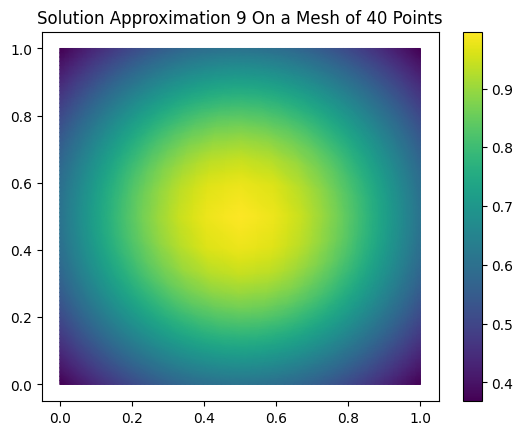





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  9
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




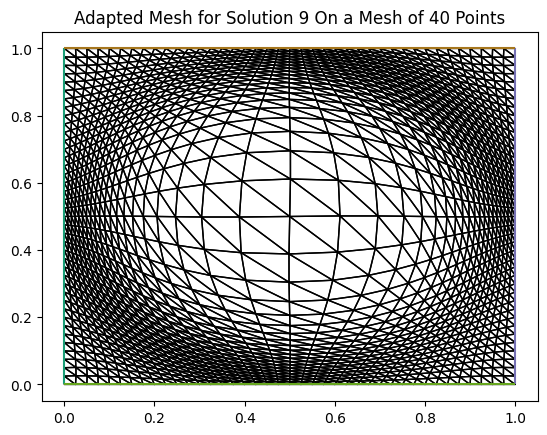



Error for Solution 9  is:  0.013696744765631664



___________________________________________________________________________
PHYSICAL SOLVE 10
___________________________________________________________________________




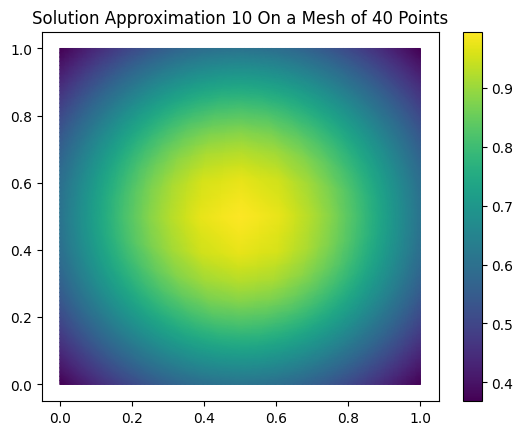





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  10
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




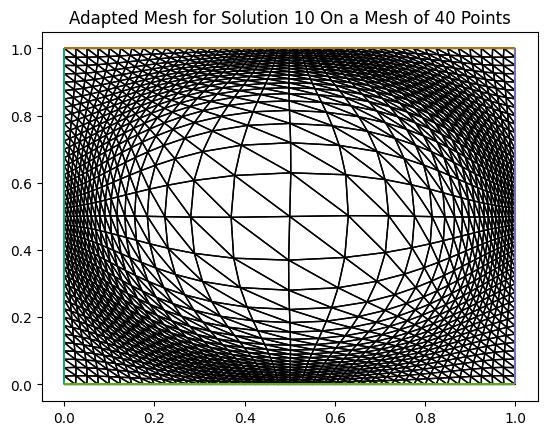



Error for Solution 10  is:  0.013536260208990956



___________________________________________________________________________
PHYSICAL SOLVE 1
___________________________________________________________________________




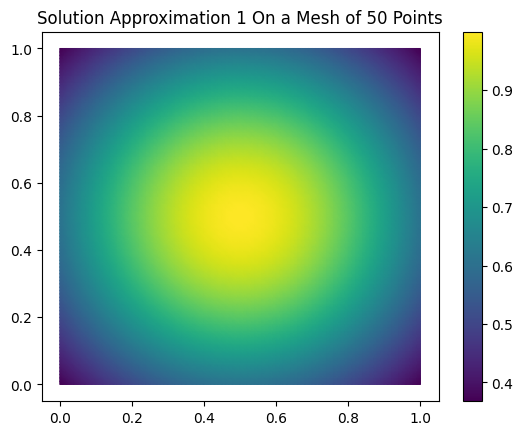





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




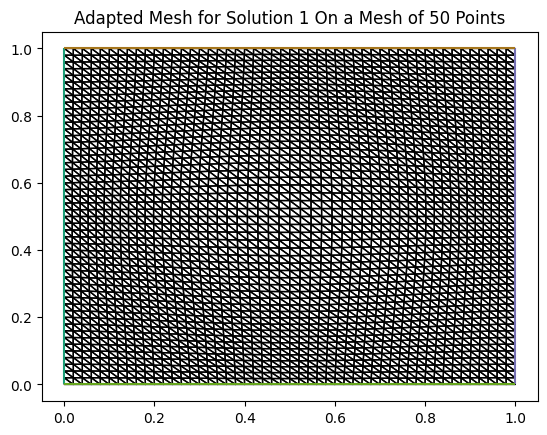



Error for Solution 1  is:  0.014123326409704222



___________________________________________________________________________
PHYSICAL SOLVE 2
___________________________________________________________________________




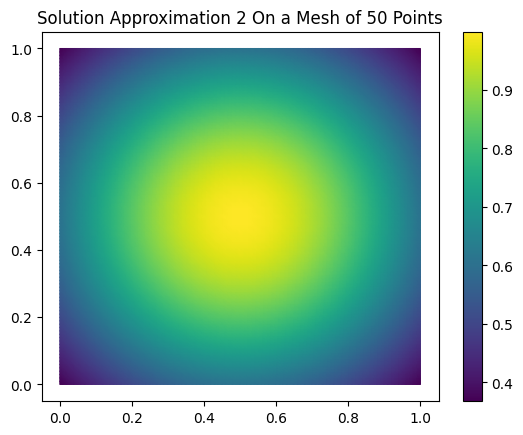





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  2
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




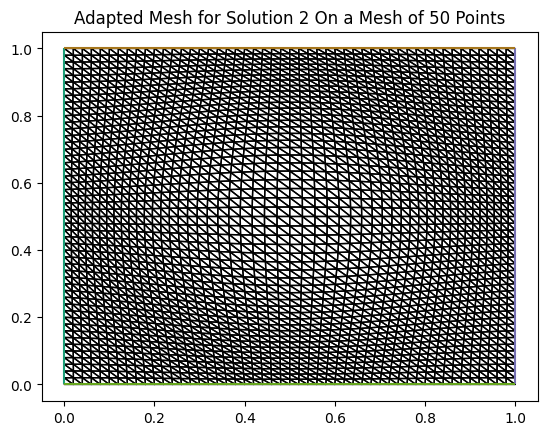



Error for Solution 2  is:  0.014122328358726004



___________________________________________________________________________
PHYSICAL SOLVE 3
___________________________________________________________________________




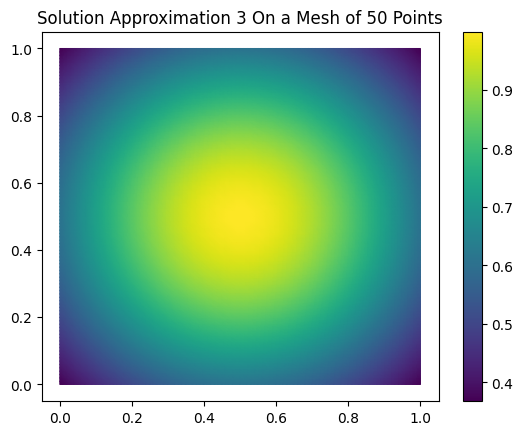





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  3
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




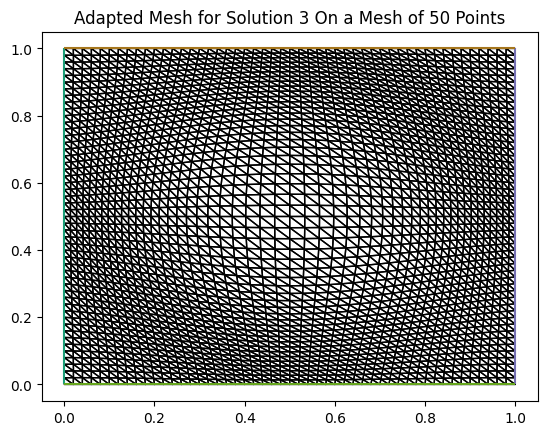



Error for Solution 3  is:  0.014116813178916108



___________________________________________________________________________
PHYSICAL SOLVE 4
___________________________________________________________________________




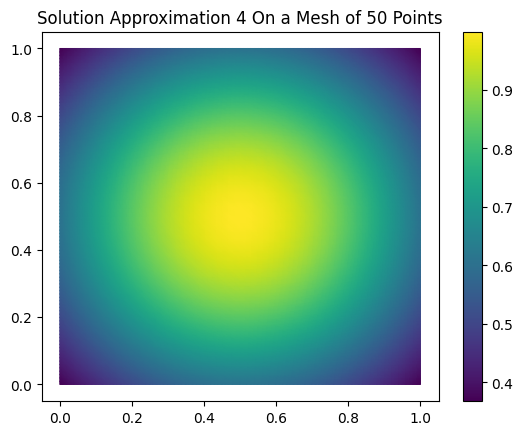





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  4
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




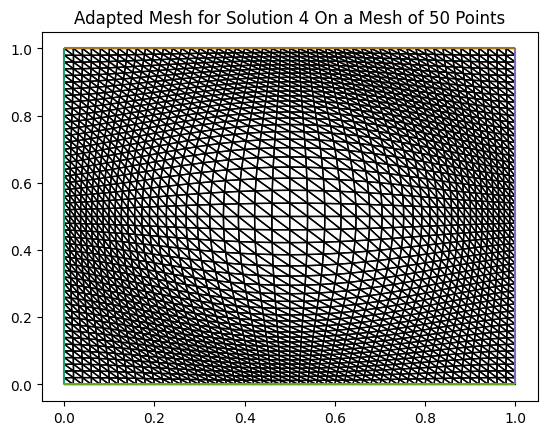



Error for Solution 4  is:  0.014106141457179458



___________________________________________________________________________
PHYSICAL SOLVE 5
___________________________________________________________________________




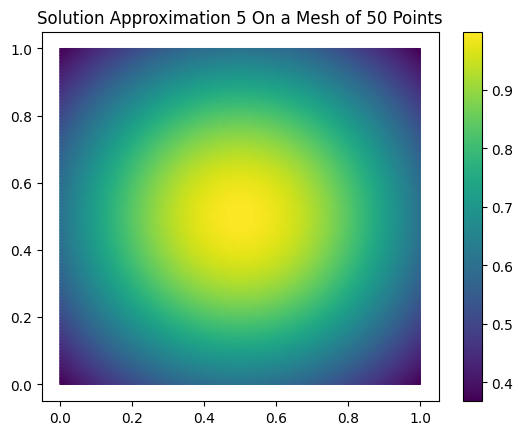





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  5
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




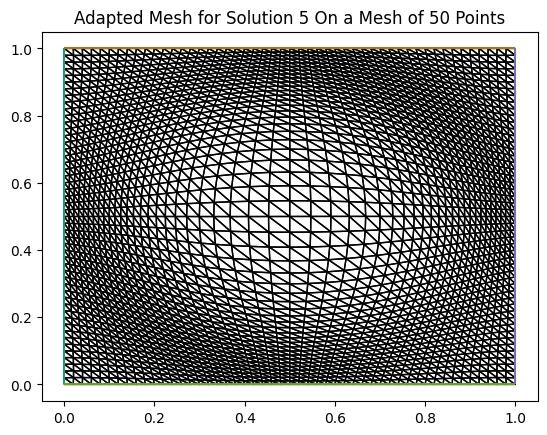



Error for Solution 5  is:  0.01408891394050564



___________________________________________________________________________
PHYSICAL SOLVE 6
___________________________________________________________________________




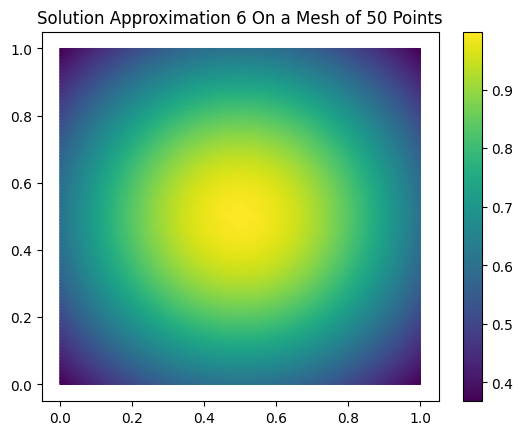





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  6
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




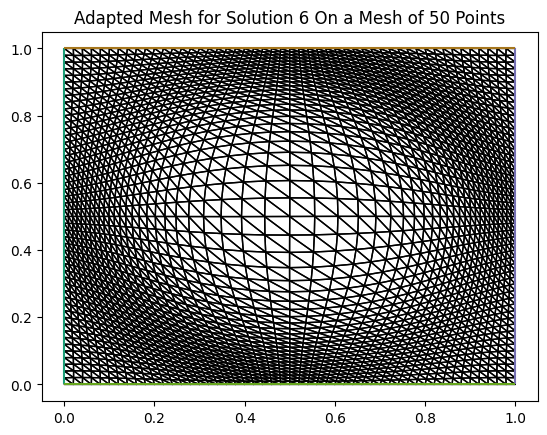



Error for Solution 6  is:  0.014062827264158017



___________________________________________________________________________
PHYSICAL SOLVE 7
___________________________________________________________________________




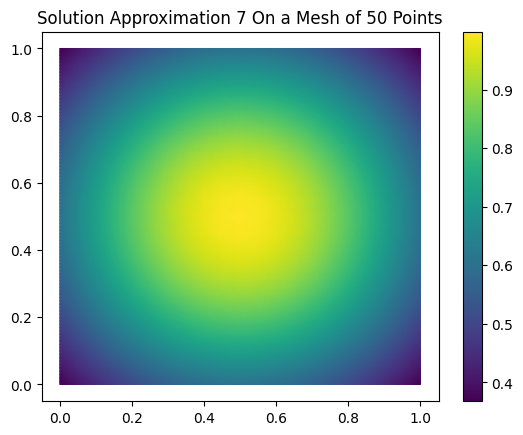





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  7
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




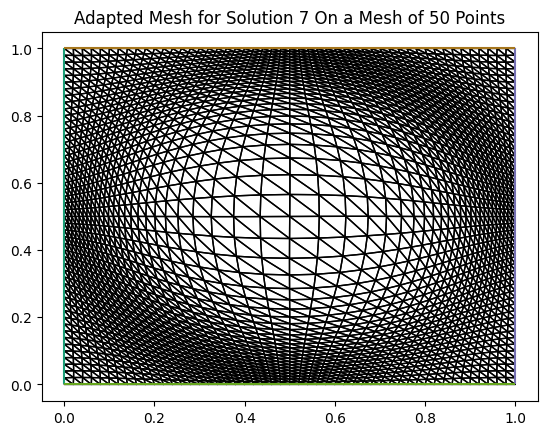



Error for Solution 7  is:  0.014024454190606942



___________________________________________________________________________
PHYSICAL SOLVE 8
___________________________________________________________________________




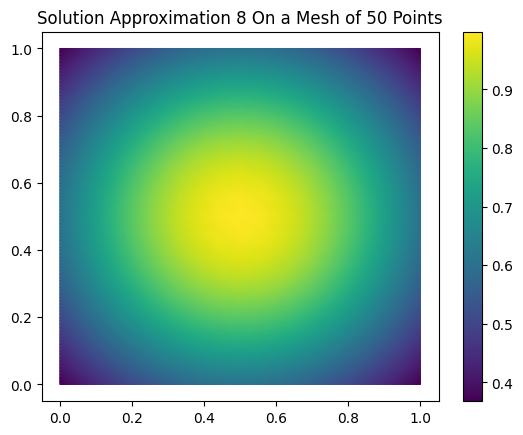





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  8
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




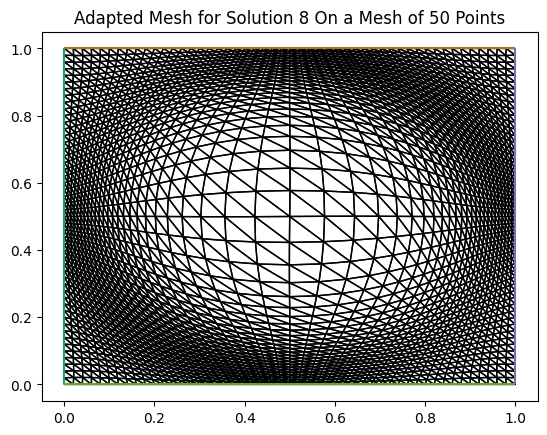



Error for Solution 8  is:  0.013968971447469797



___________________________________________________________________________
PHYSICAL SOLVE 9
___________________________________________________________________________




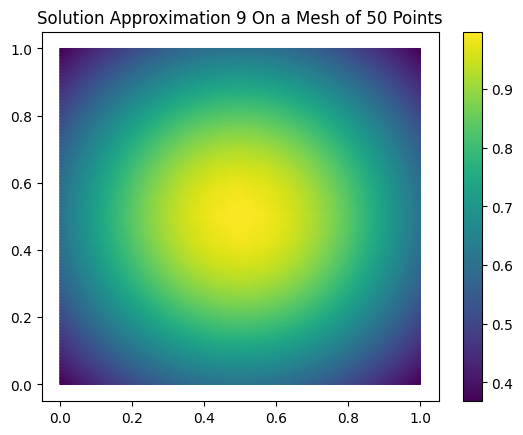





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  9
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




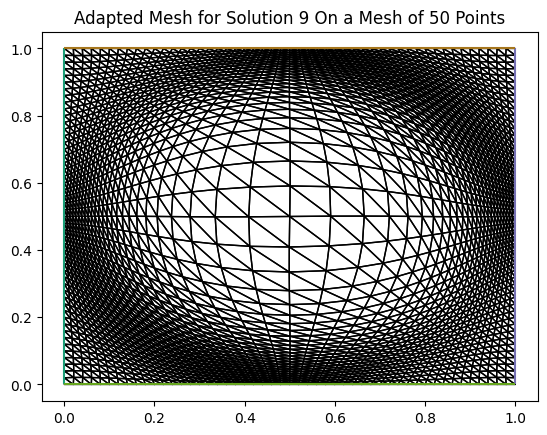



Error for Solution 9  is:  0.013889891335132824



___________________________________________________________________________
PHYSICAL SOLVE 10
___________________________________________________________________________




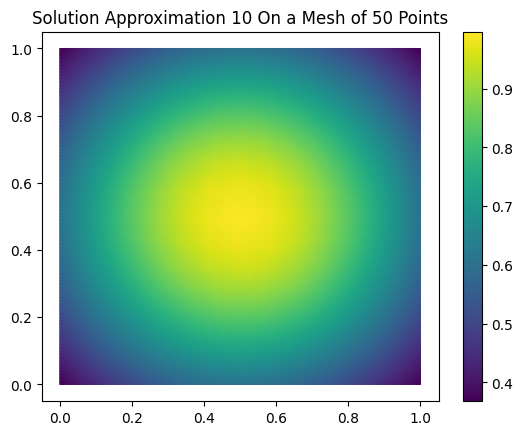





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  10
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




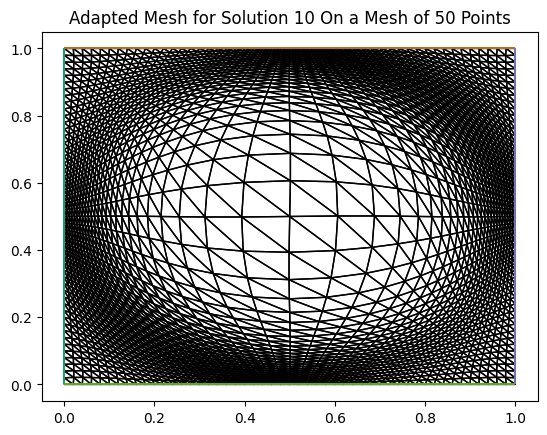



Error for Solution 10  is:  0.013778928347185937



___________________________________________________________________________
PHYSICAL SOLVE 1
___________________________________________________________________________




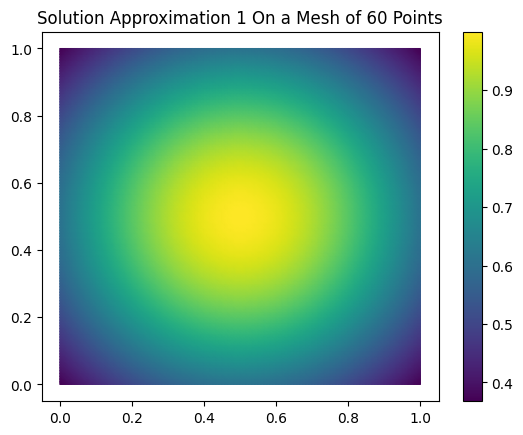





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




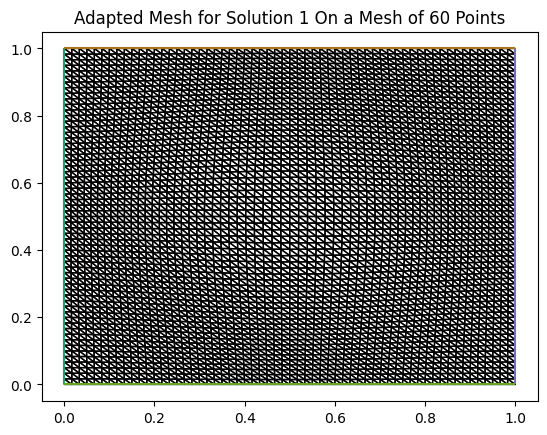



Error for Solution 1  is:  0.014164201121812083



___________________________________________________________________________
PHYSICAL SOLVE 2
___________________________________________________________________________




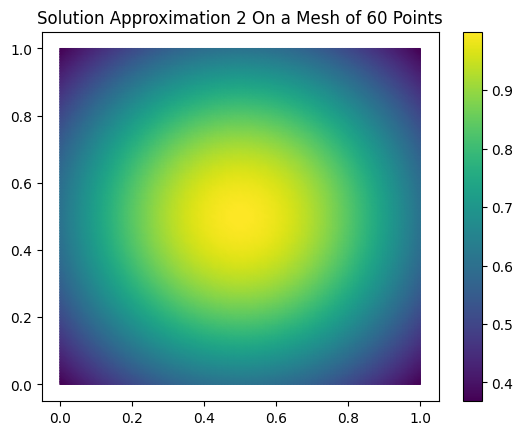





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  2
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




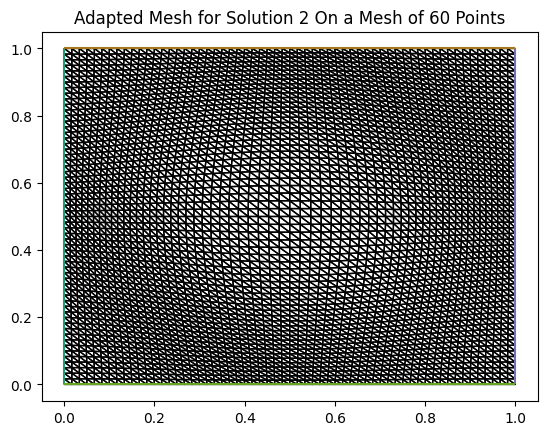



Error for Solution 2  is:  0.014163504440004637



___________________________________________________________________________
PHYSICAL SOLVE 3
___________________________________________________________________________




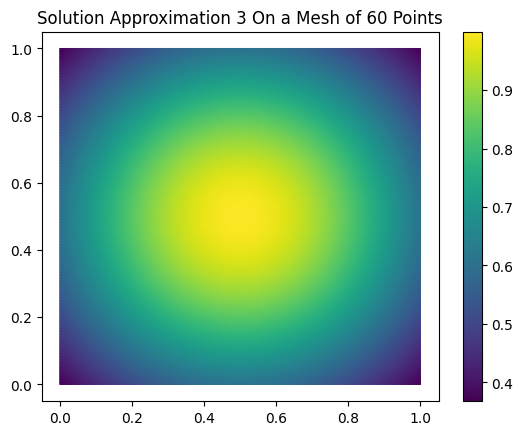





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  3
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




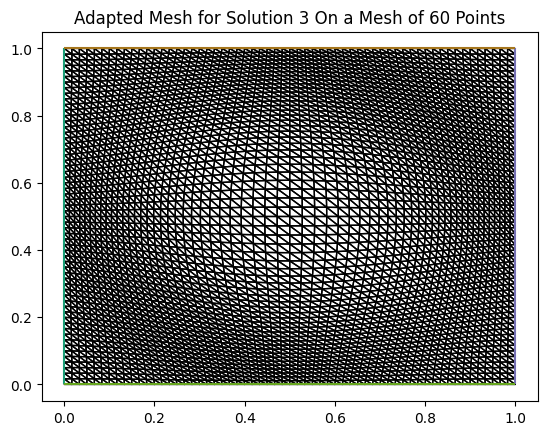



Error for Solution 3  is:  0.014159653351601372



___________________________________________________________________________
PHYSICAL SOLVE 4
___________________________________________________________________________




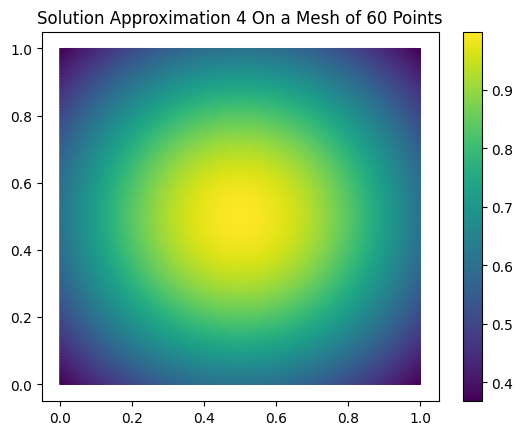





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  4
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




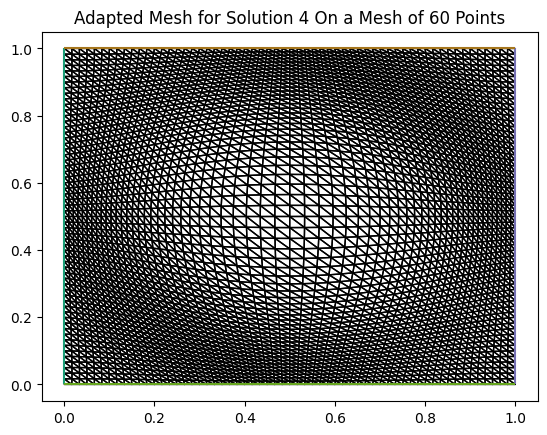



Error for Solution 4  is:  0.01415219416314742



___________________________________________________________________________
PHYSICAL SOLVE 5
___________________________________________________________________________




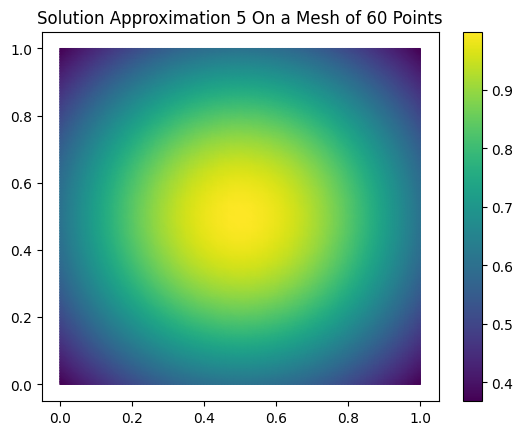





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  5
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




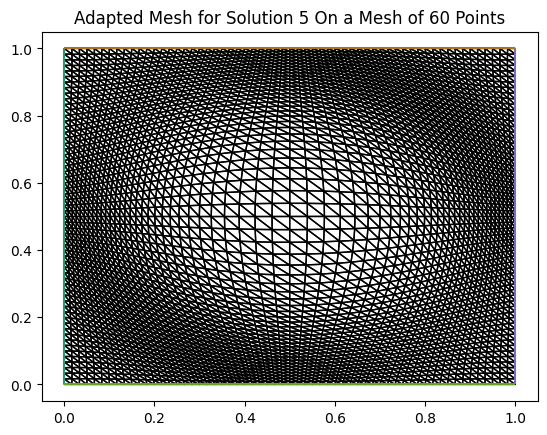



Error for Solution 5  is:  0.01414013034426226



___________________________________________________________________________
PHYSICAL SOLVE 6
___________________________________________________________________________




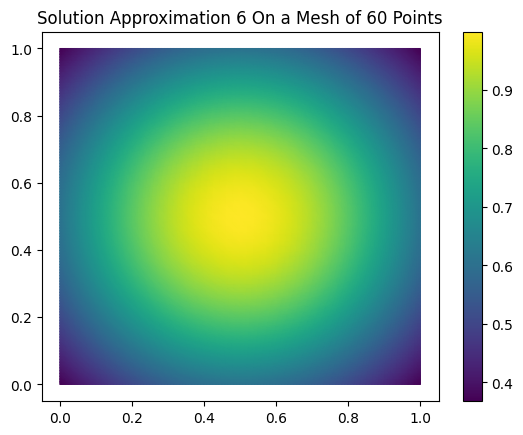





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  6
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




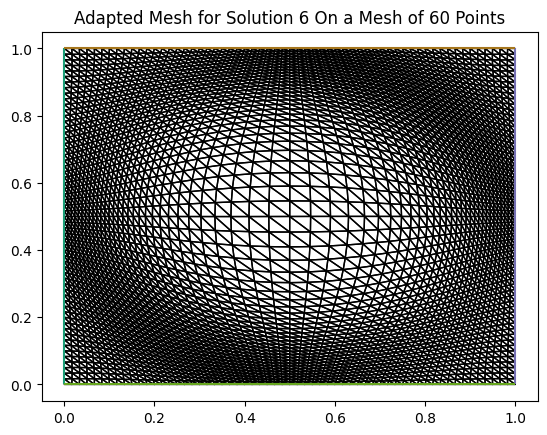



Error for Solution 6  is:  0.014121809268509257



___________________________________________________________________________
PHYSICAL SOLVE 7
___________________________________________________________________________




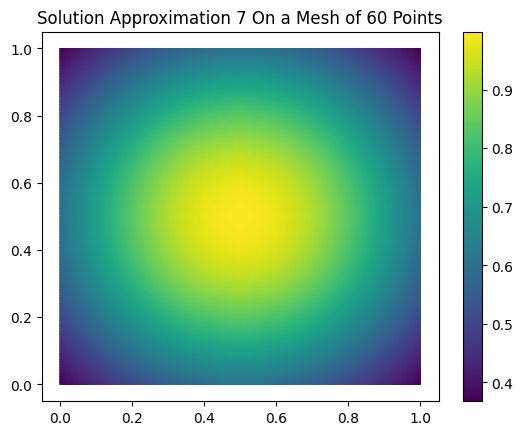





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  7
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




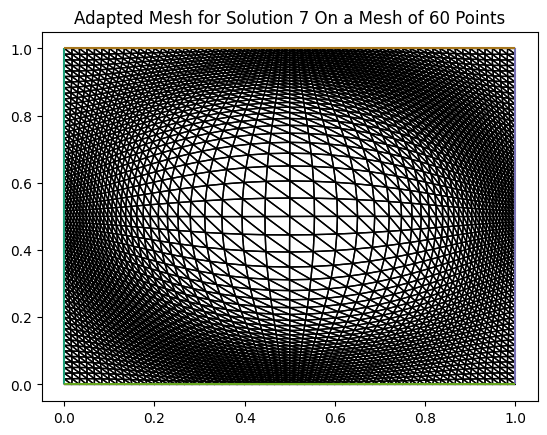



Error for Solution 7  is:  0.014094742754498114



___________________________________________________________________________
PHYSICAL SOLVE 8
___________________________________________________________________________




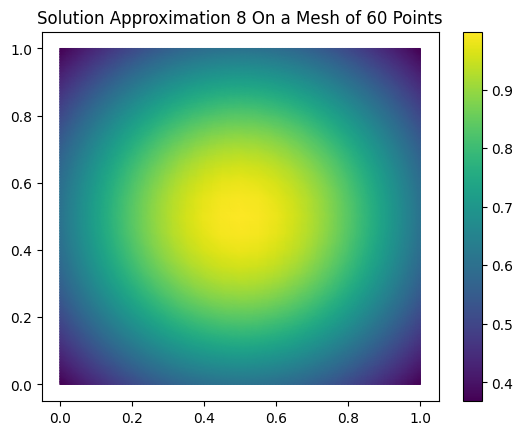





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  8
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




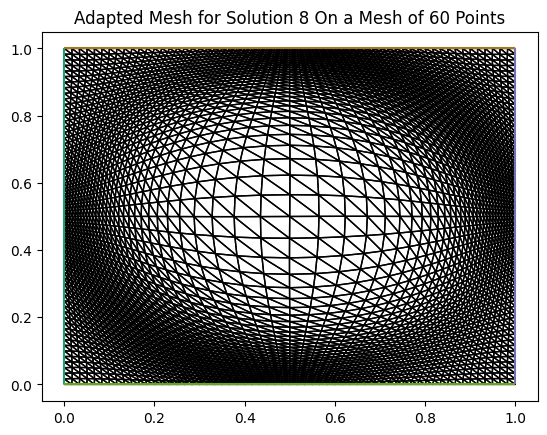



Error for Solution 8  is:  0.014055366856671223



___________________________________________________________________________
PHYSICAL SOLVE 9
___________________________________________________________________________




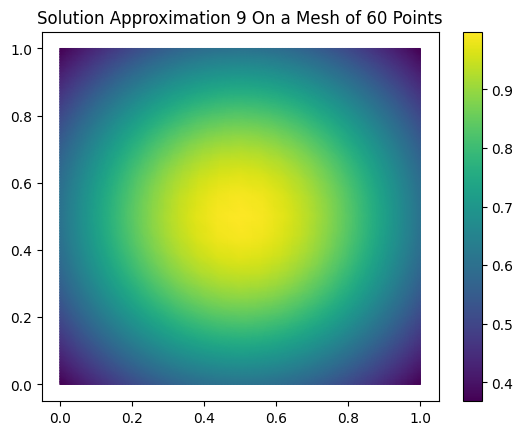





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  9
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




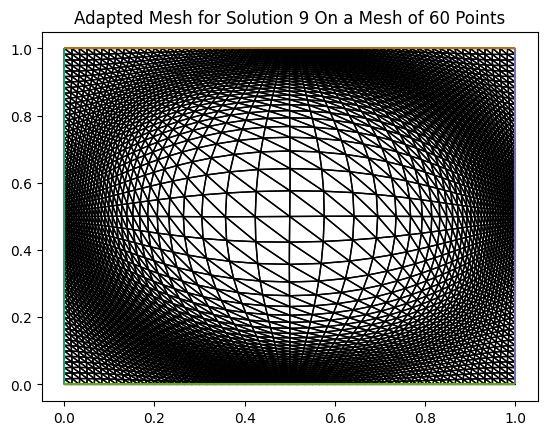



Error for Solution 9  is:  0.013998759877688319



___________________________________________________________________________
PHYSICAL SOLVE 10
___________________________________________________________________________




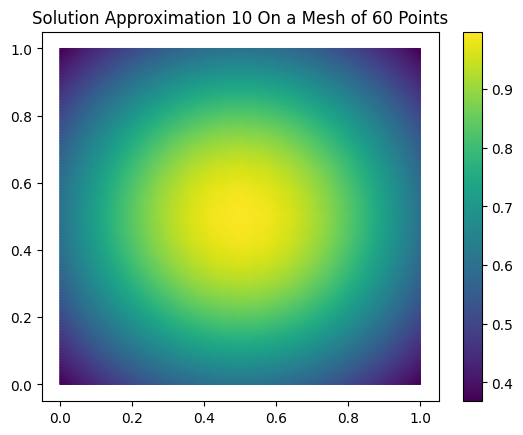





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  10
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




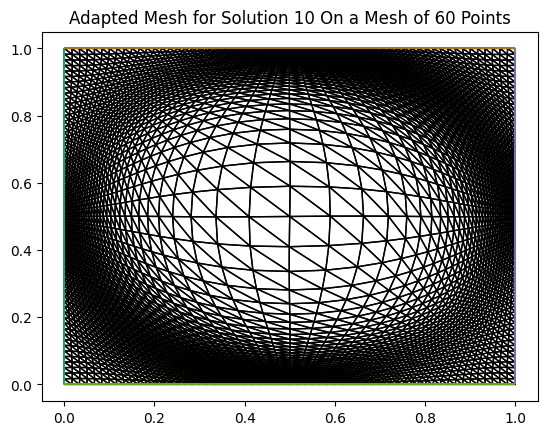



Error for Solution 10  is:  0.01391836982154603



___________________________________________________________________________
PHYSICAL SOLVE 1
___________________________________________________________________________




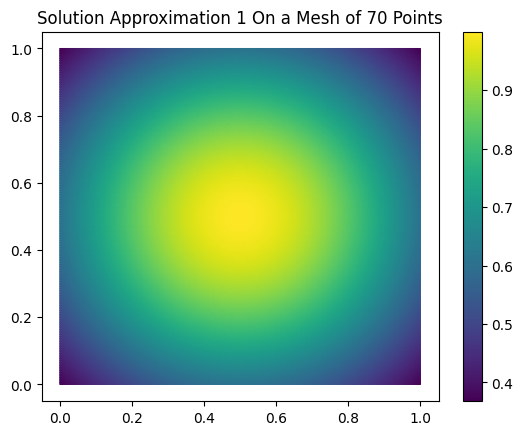





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




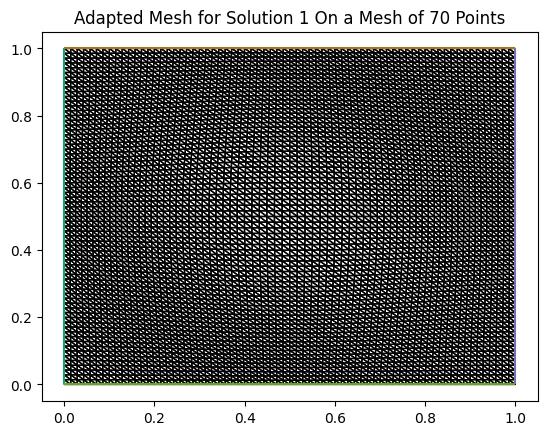



Error for Solution 1  is:  0.014188872547310901



___________________________________________________________________________
PHYSICAL SOLVE 2
___________________________________________________________________________




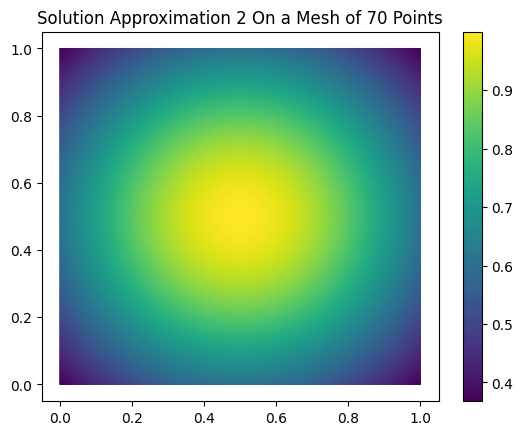





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  2
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




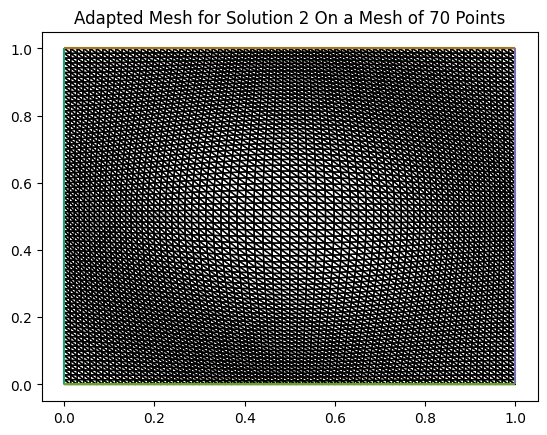



Error for Solution 2  is:  0.014188359111435041



___________________________________________________________________________
PHYSICAL SOLVE 3
___________________________________________________________________________




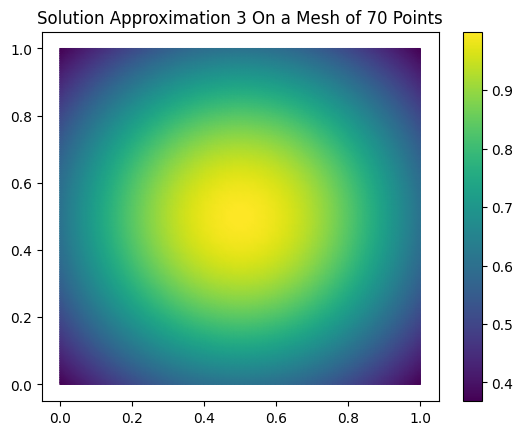





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  3
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




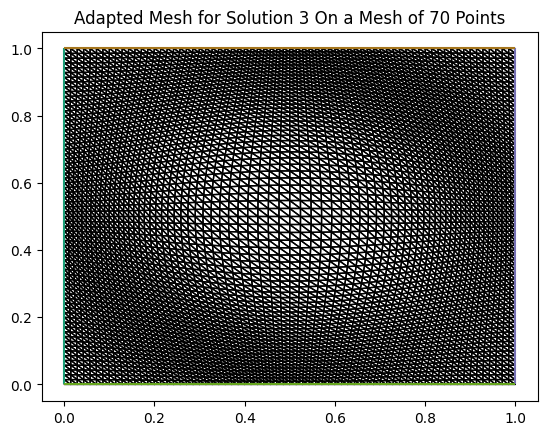



Error for Solution 3  is:  0.014185520376372171



___________________________________________________________________________
PHYSICAL SOLVE 4
___________________________________________________________________________




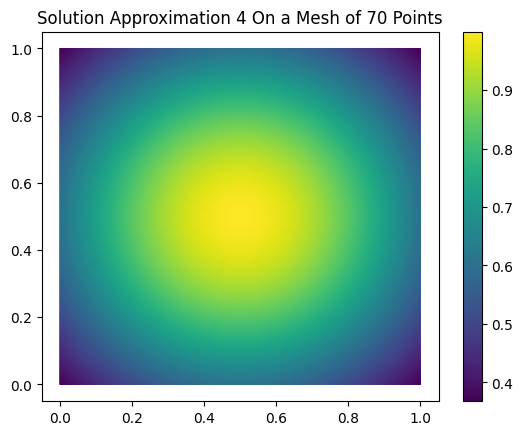





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  4
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




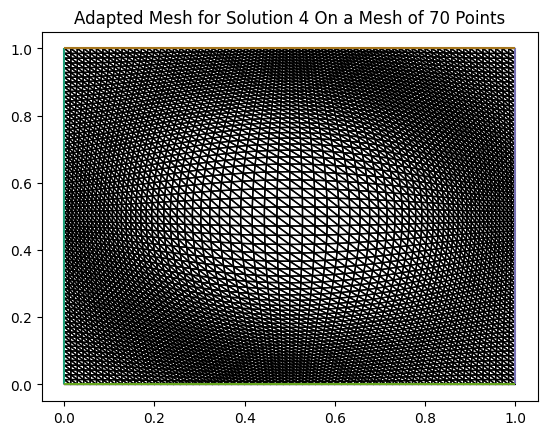



Error for Solution 4  is:  0.014180018713388956



___________________________________________________________________________
PHYSICAL SOLVE 5
___________________________________________________________________________




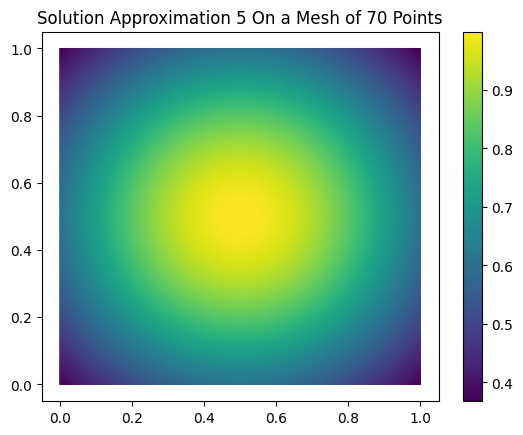





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  5
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




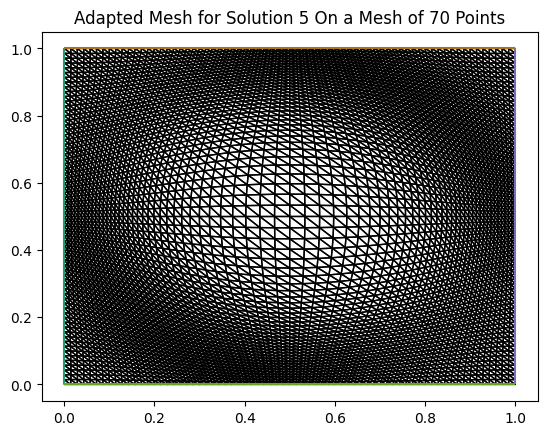



Error for Solution 5  is:  0.014171110865011972



___________________________________________________________________________
PHYSICAL SOLVE 6
___________________________________________________________________________




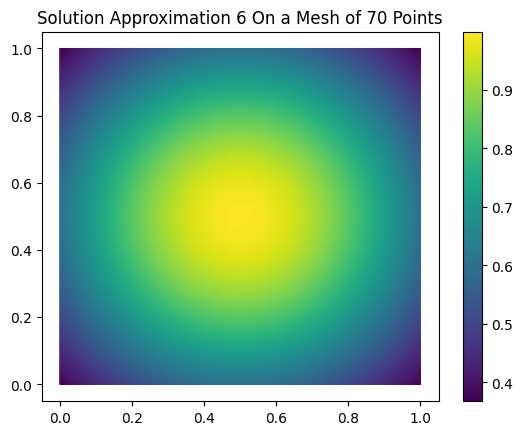





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  6
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




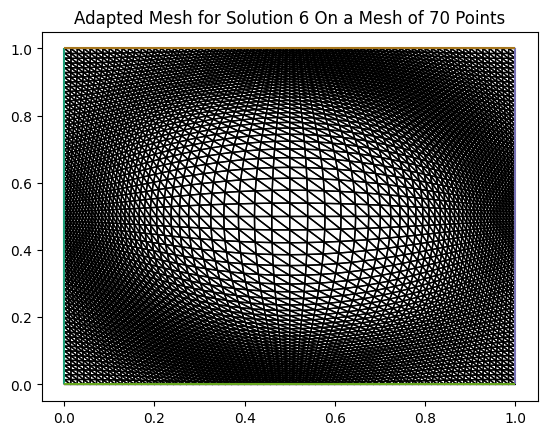



Error for Solution 6  is:  0.014157558731791229



___________________________________________________________________________
PHYSICAL SOLVE 7
___________________________________________________________________________




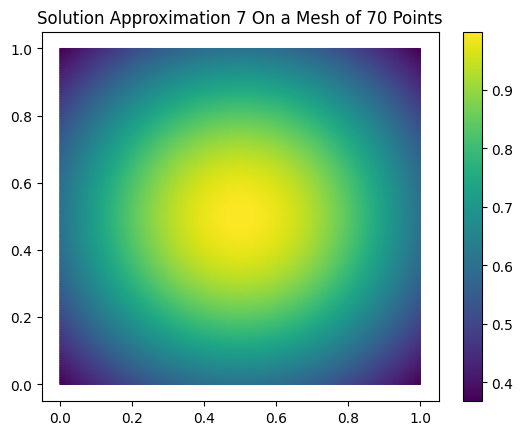





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  7
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




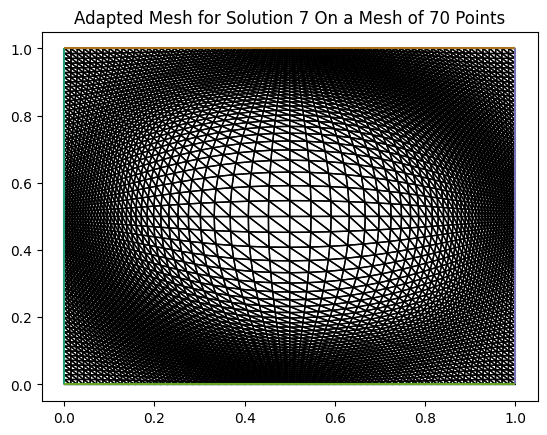



Error for Solution 7  is:  0.014137484948840809



___________________________________________________________________________
PHYSICAL SOLVE 8
___________________________________________________________________________




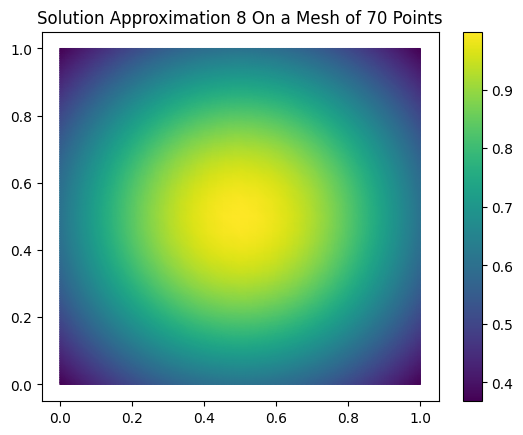





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  8
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




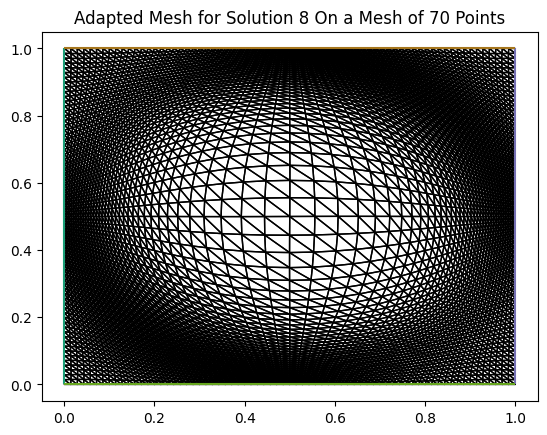



Error for Solution 8  is:  0.014108171862243859



___________________________________________________________________________
PHYSICAL SOLVE 9
___________________________________________________________________________




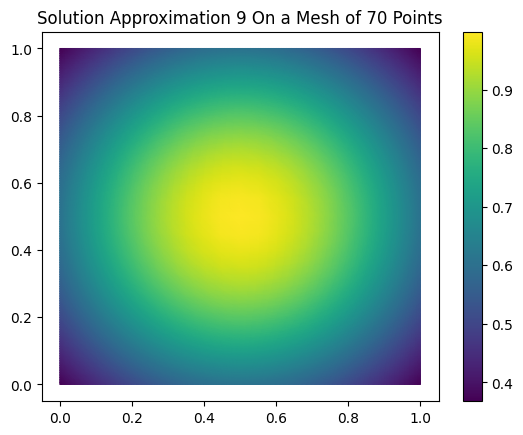





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  9
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




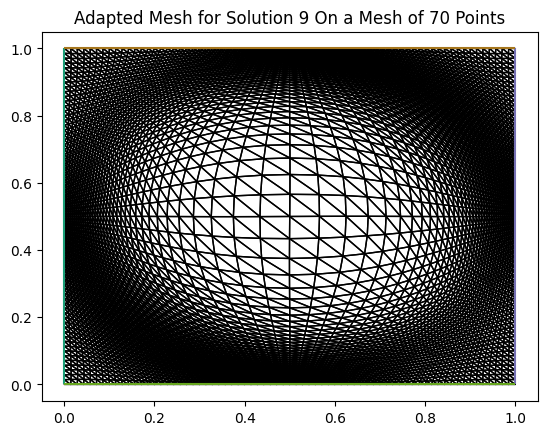



Error for Solution 9  is:  0.014065808323332993



___________________________________________________________________________
PHYSICAL SOLVE 10
___________________________________________________________________________




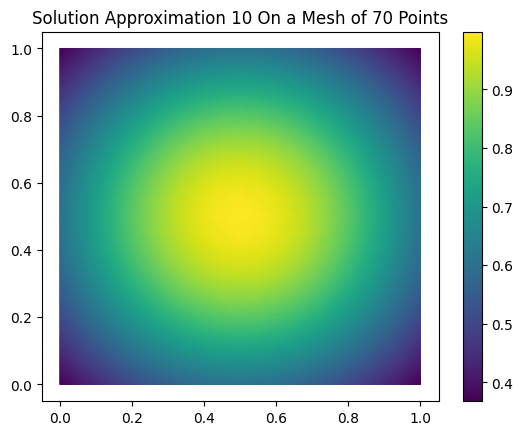





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  10
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




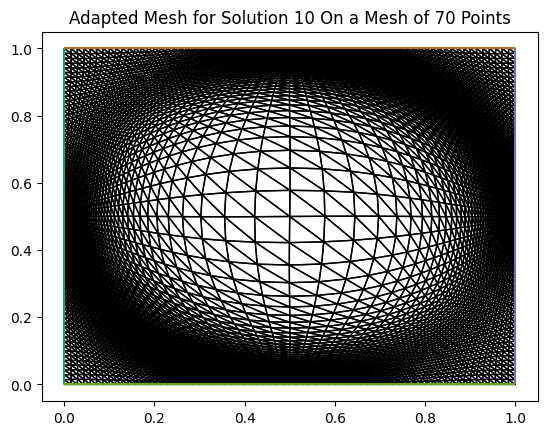



Error for Solution 10  is:  0.014005204192566704



___________________________________________________________________________
PHYSICAL SOLVE 1
___________________________________________________________________________




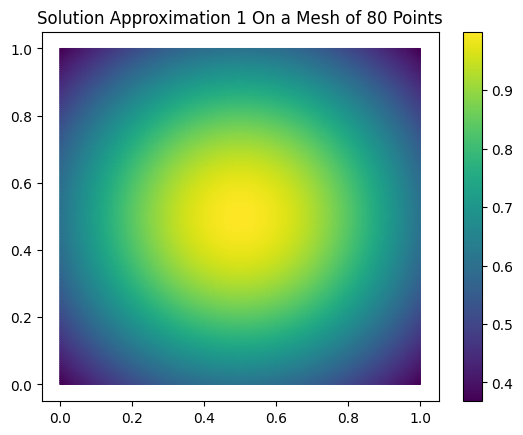





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




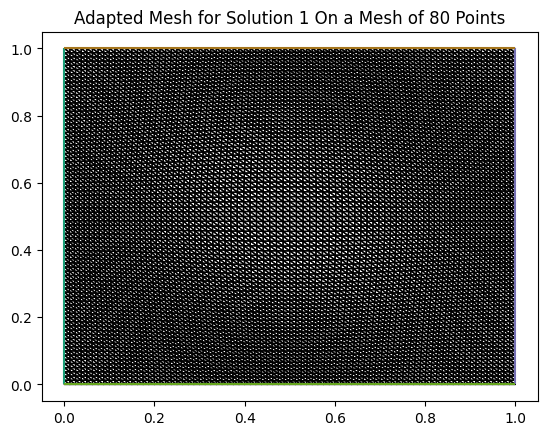



Error for Solution 1  is:  0.014204895415288667



___________________________________________________________________________
PHYSICAL SOLVE 2
___________________________________________________________________________




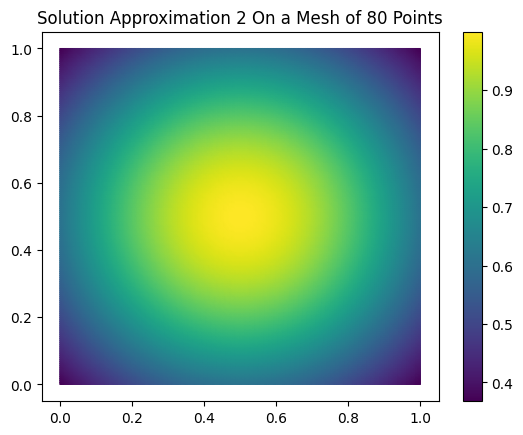





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  2
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




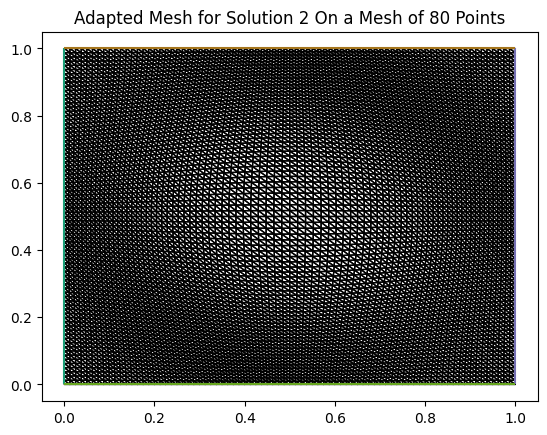



Error for Solution 2  is:  0.014204501527650812



___________________________________________________________________________
PHYSICAL SOLVE 3
___________________________________________________________________________




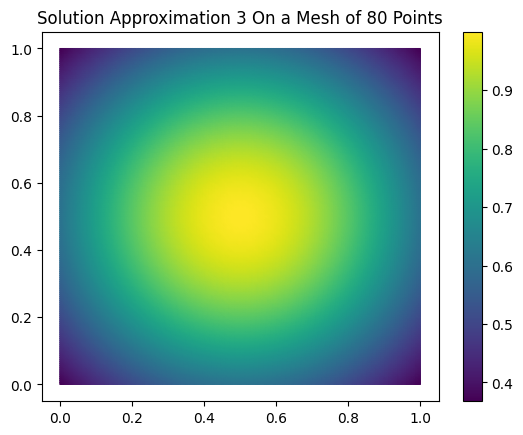





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  3
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




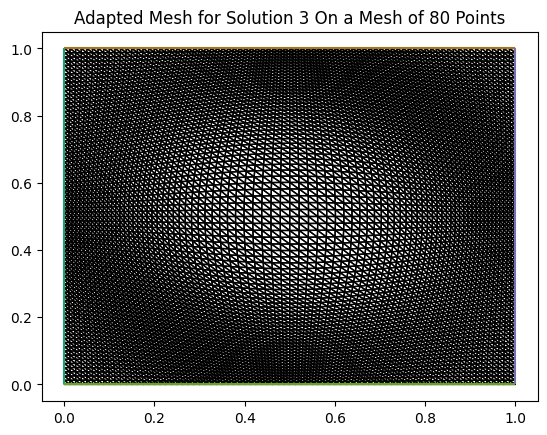



Error for Solution 3  is:  0.014202323463155135



___________________________________________________________________________
PHYSICAL SOLVE 4
___________________________________________________________________________




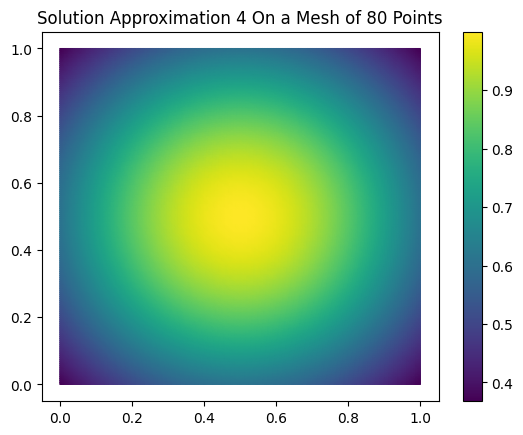





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  4
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




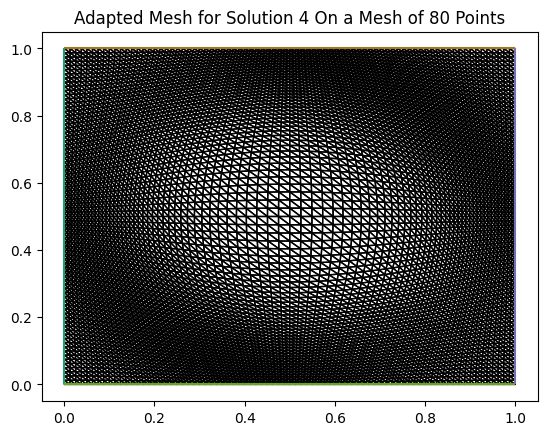



Error for Solution 4  is:  0.014198100579301305



___________________________________________________________________________
PHYSICAL SOLVE 5
___________________________________________________________________________




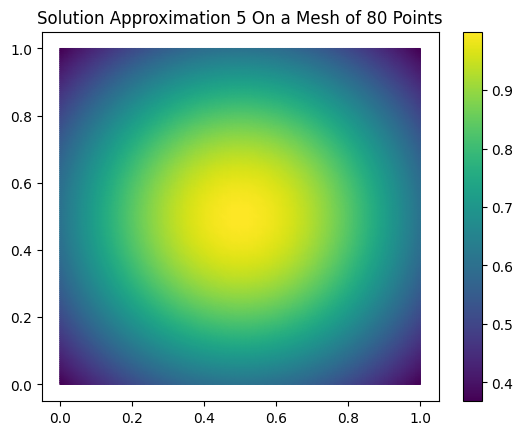





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  5
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




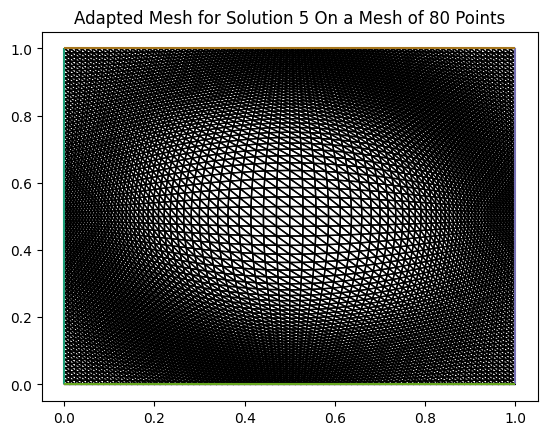



Error for Solution 5  is:  0.014191258263864952



___________________________________________________________________________
PHYSICAL SOLVE 6
___________________________________________________________________________




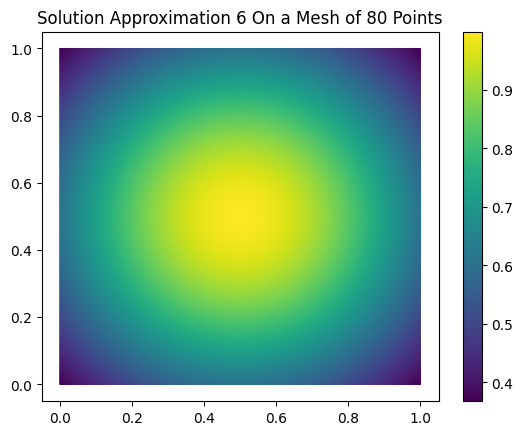





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  6
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




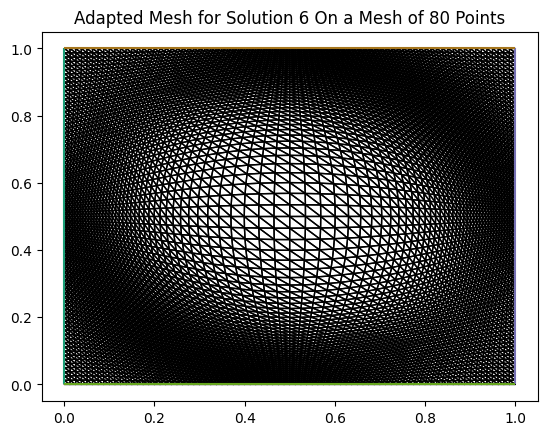



Error for Solution 6  is:  0.014180836584776594



___________________________________________________________________________
PHYSICAL SOLVE 7
___________________________________________________________________________




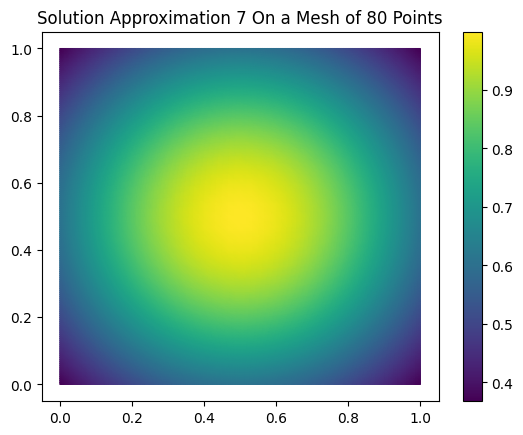





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  7
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




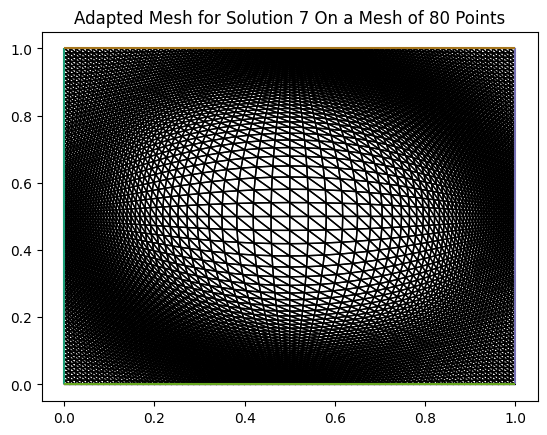



Error for Solution 7  is:  0.014165373253467091



___________________________________________________________________________
PHYSICAL SOLVE 8
___________________________________________________________________________




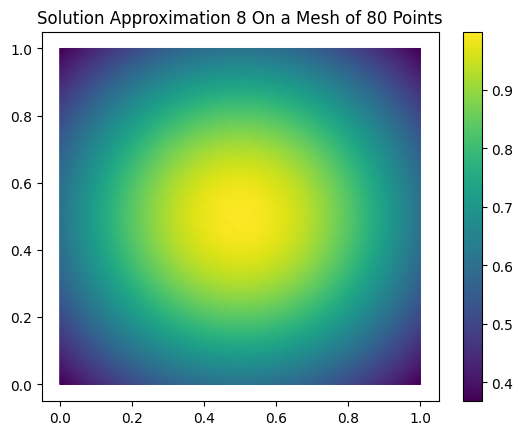





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  8
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




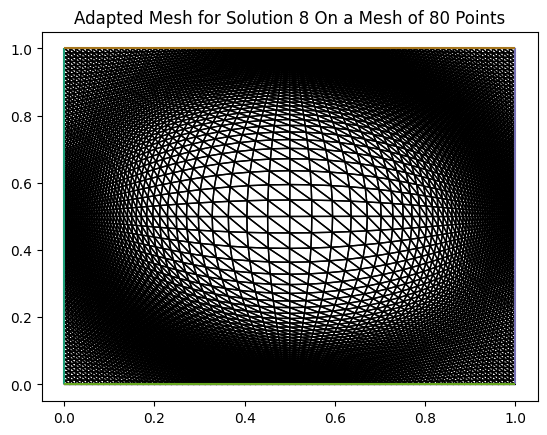



Error for Solution 8  is:  0.014142736872900607



___________________________________________________________________________
PHYSICAL SOLVE 9
___________________________________________________________________________




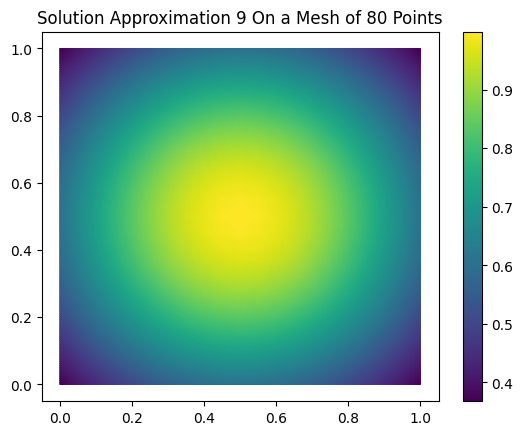





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  9
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




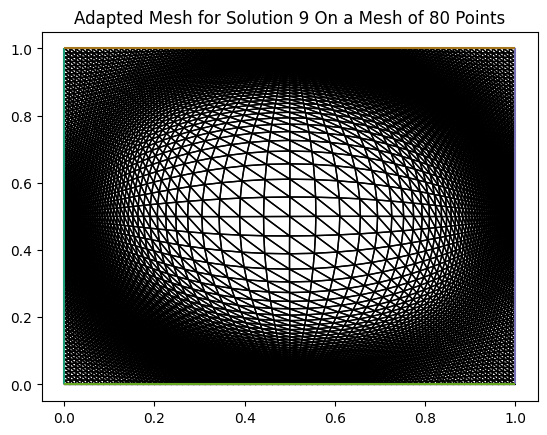



Error for Solution 9  is:  0.01410990851289737



___________________________________________________________________________
PHYSICAL SOLVE 10
___________________________________________________________________________




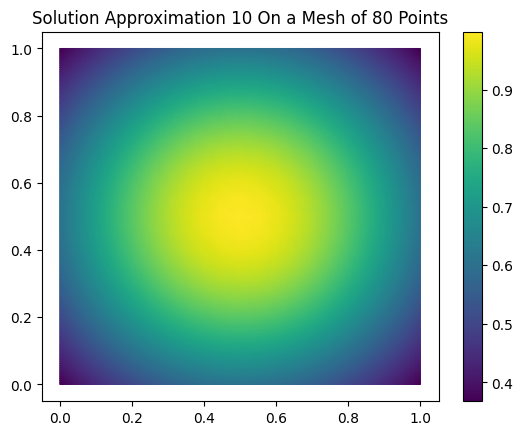





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  10
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




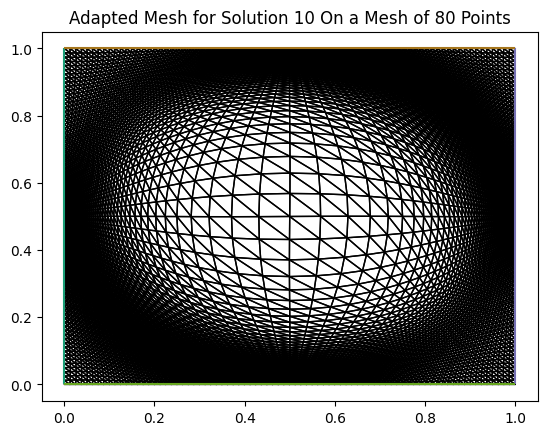



Error for Solution 10  is:  0.014062717560575488



___________________________________________________________________________
PHYSICAL SOLVE 1
___________________________________________________________________________




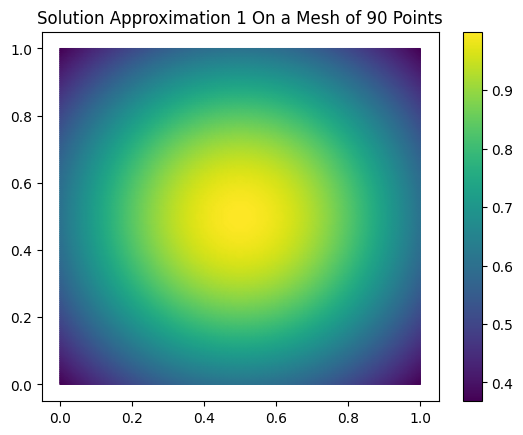





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




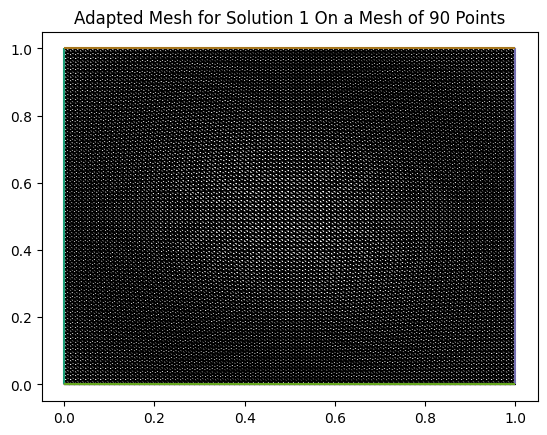



Error for Solution 1  is:  0.014215885261852787



___________________________________________________________________________
PHYSICAL SOLVE 2
___________________________________________________________________________




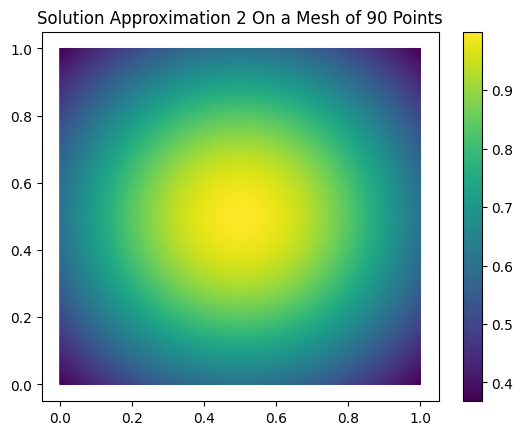





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  2
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




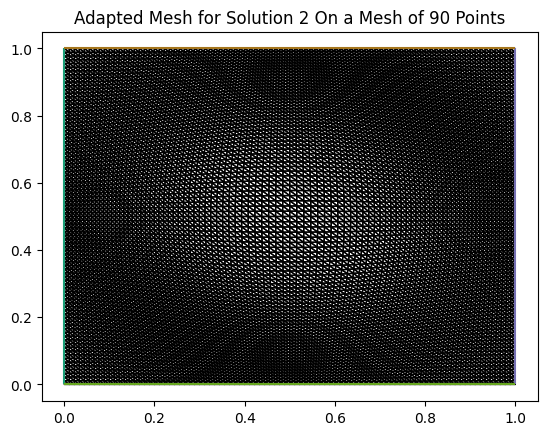



Error for Solution 2  is:  0.014215573615256823



___________________________________________________________________________
PHYSICAL SOLVE 3
___________________________________________________________________________




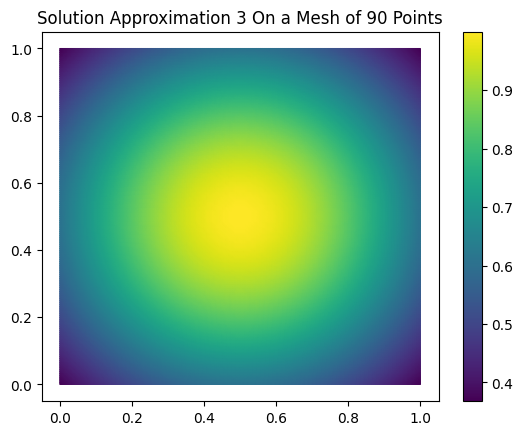





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  3
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




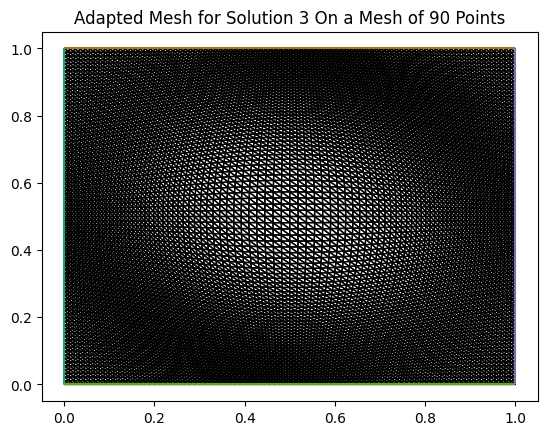



Error for Solution 3  is:  0.014213850150447687



___________________________________________________________________________
PHYSICAL SOLVE 4
___________________________________________________________________________




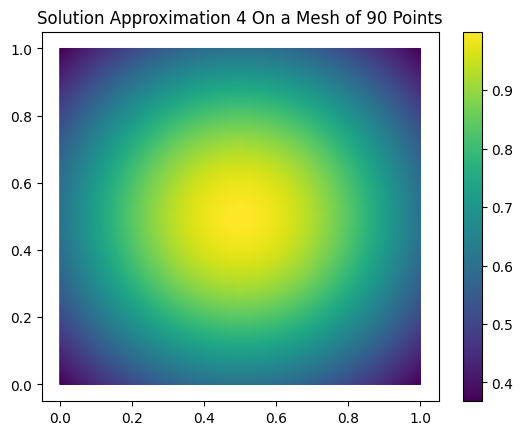





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  4
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




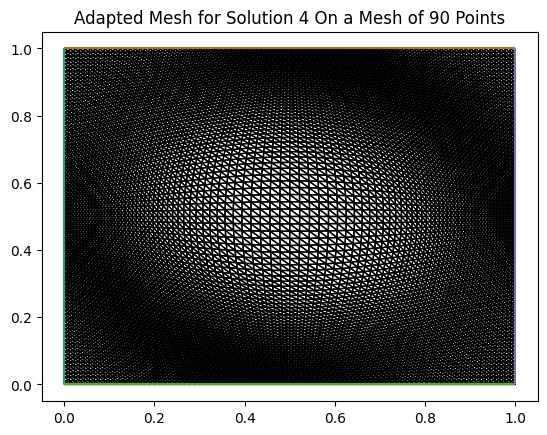



Error for Solution 4  is:  0.014210507762917999



___________________________________________________________________________
PHYSICAL SOLVE 5
___________________________________________________________________________




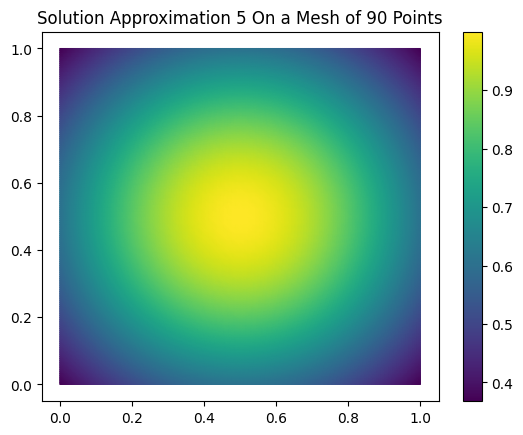





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  5
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




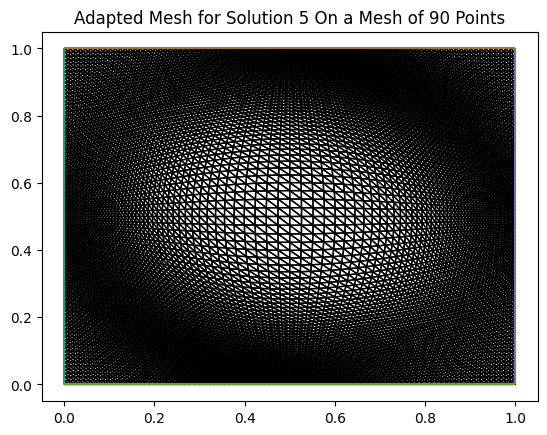



Error for Solution 5  is:  0.01420508941687822



___________________________________________________________________________
PHYSICAL SOLVE 6
___________________________________________________________________________




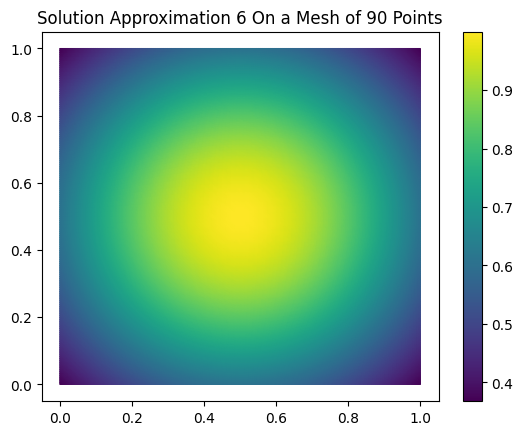





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  6
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




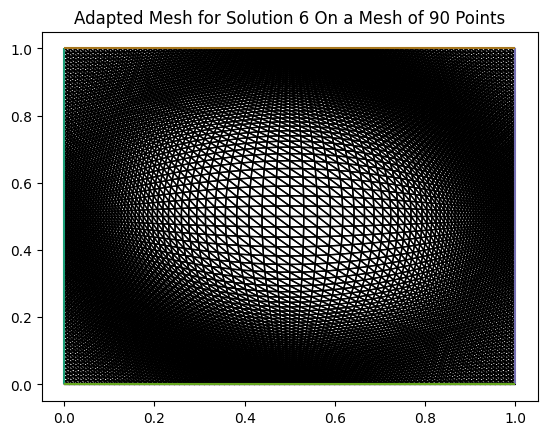



Error for Solution 6  is:  0.01419683009761583



___________________________________________________________________________
PHYSICAL SOLVE 7
___________________________________________________________________________




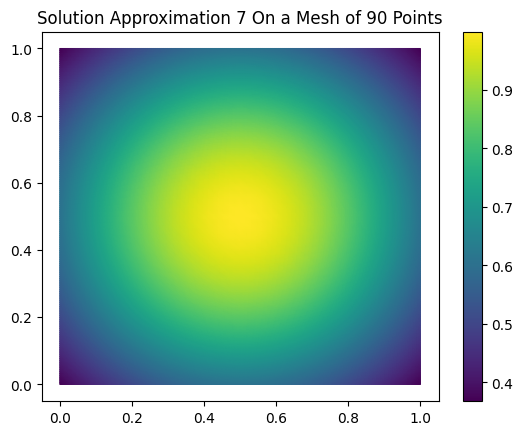





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  7
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




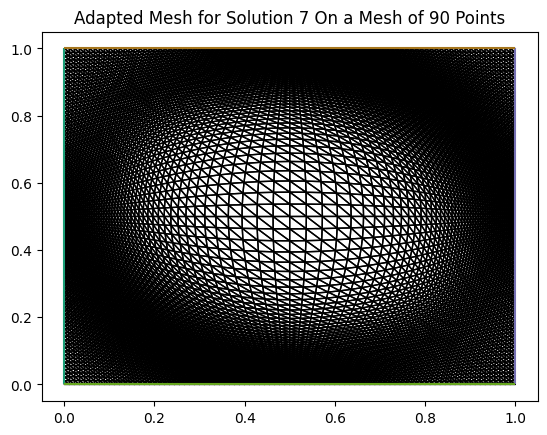



Error for Solution 7  is:  0.01418456076170195



___________________________________________________________________________
PHYSICAL SOLVE 8
___________________________________________________________________________




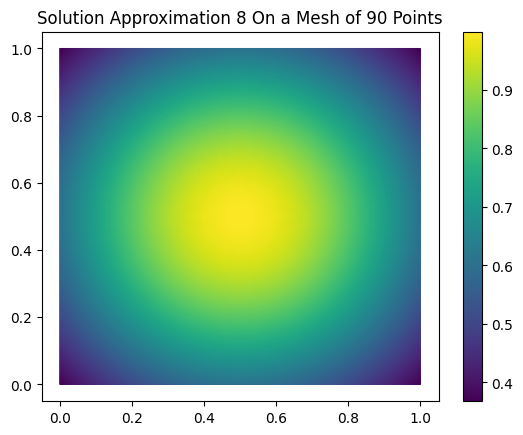





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  8
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




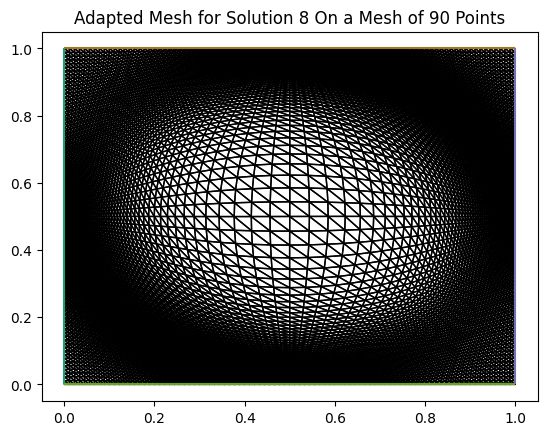



Error for Solution 8  is:  0.01416656938639165



___________________________________________________________________________
PHYSICAL SOLVE 9
___________________________________________________________________________




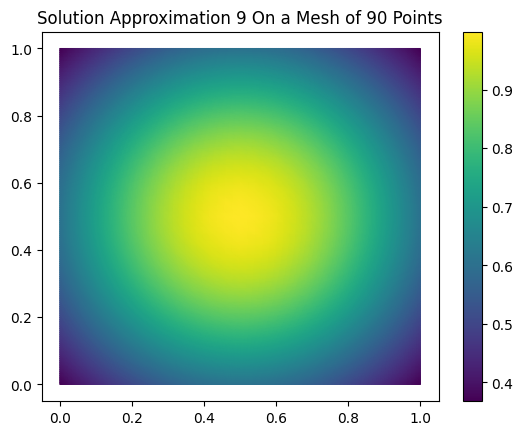





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  9
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




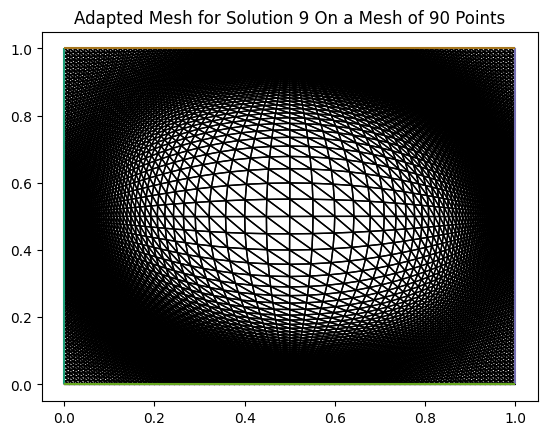



Error for Solution 9  is:  0.014140414389309856



___________________________________________________________________________
PHYSICAL SOLVE 10
___________________________________________________________________________




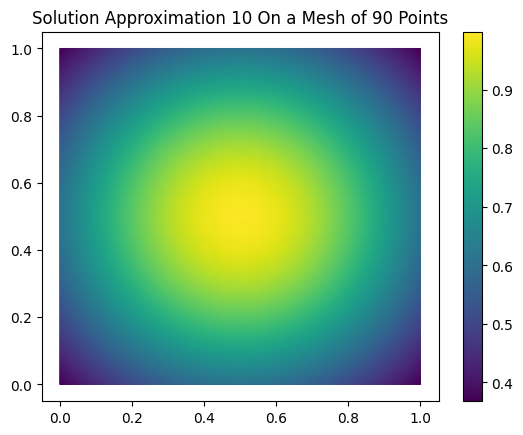





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  10
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




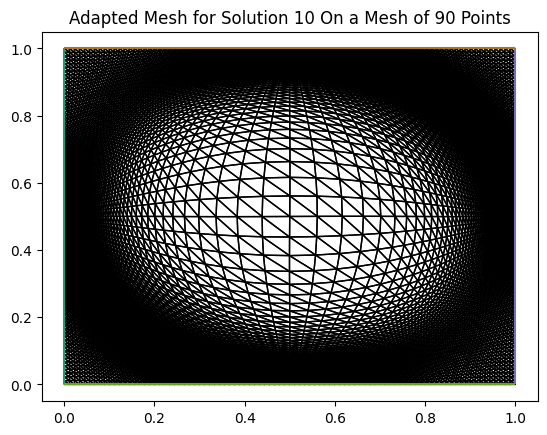



Error for Solution 10  is:  0.014102689539685766



___________________________________________________________________________
PHYSICAL SOLVE 1
___________________________________________________________________________




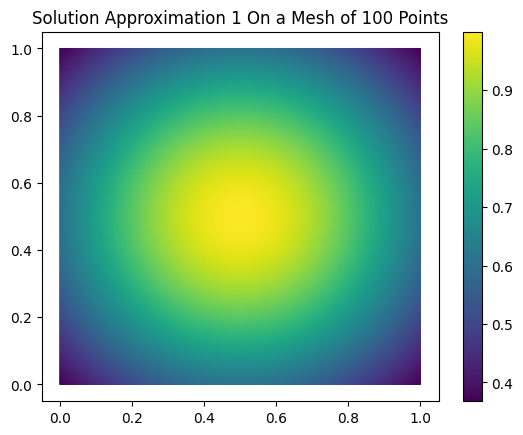





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




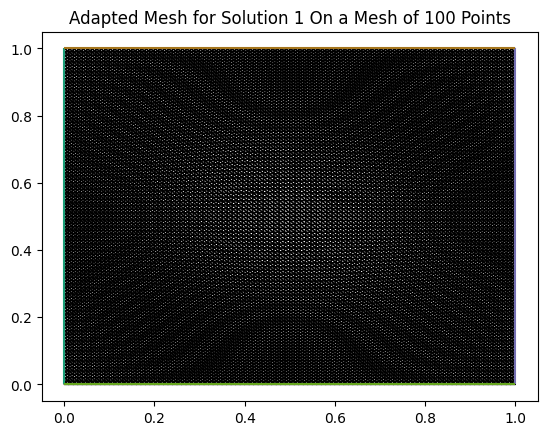



Error for Solution 1  is:  0.014223748539922075



___________________________________________________________________________
PHYSICAL SOLVE 2
___________________________________________________________________________




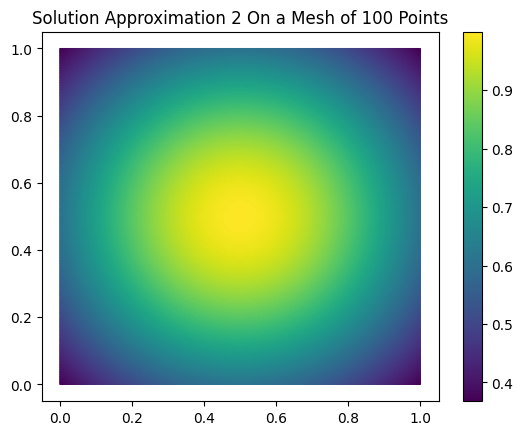





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  2
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




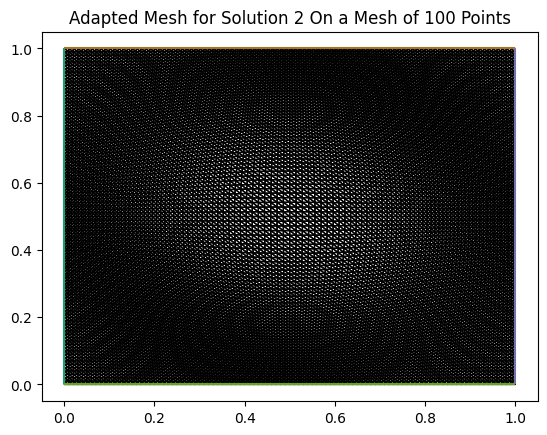



Error for Solution 2  is:  0.014223495859031637



___________________________________________________________________________
PHYSICAL SOLVE 3
___________________________________________________________________________




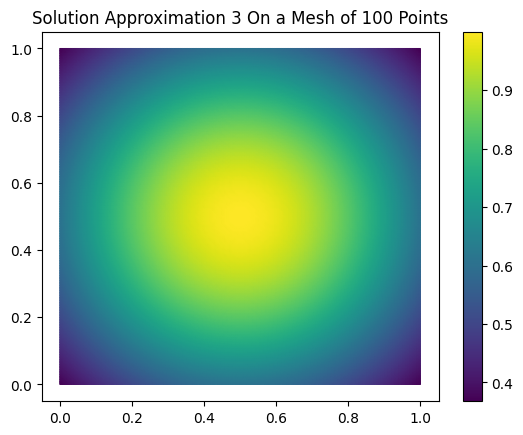





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  3
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




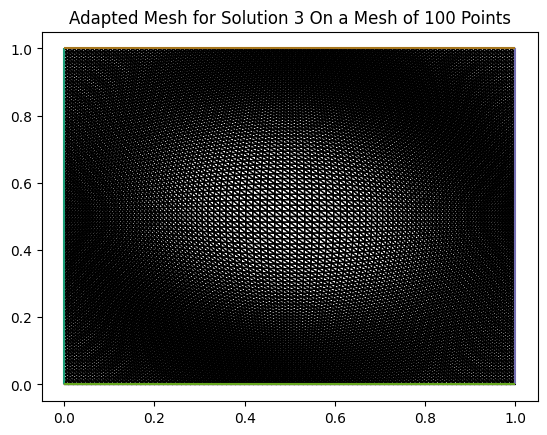



Error for Solution 3  is:  0.014222098388906564



___________________________________________________________________________
PHYSICAL SOLVE 4
___________________________________________________________________________




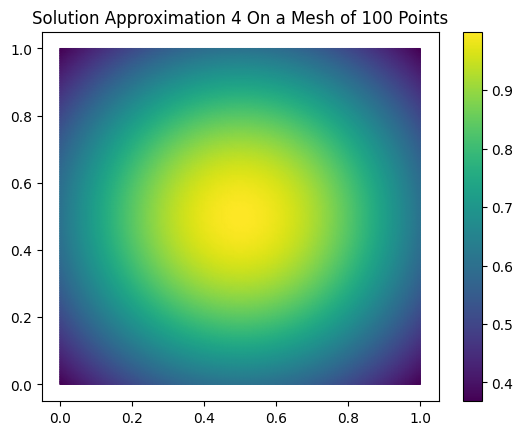





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  4
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




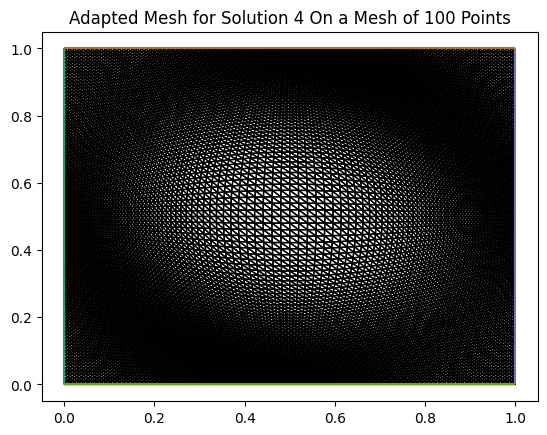



Error for Solution 4  is:  0.014219387699051842



___________________________________________________________________________
PHYSICAL SOLVE 5
___________________________________________________________________________




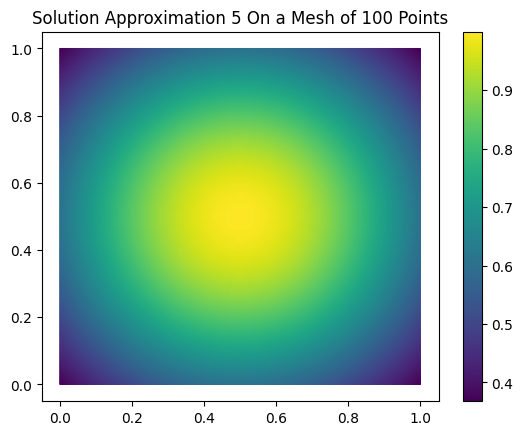





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  5
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




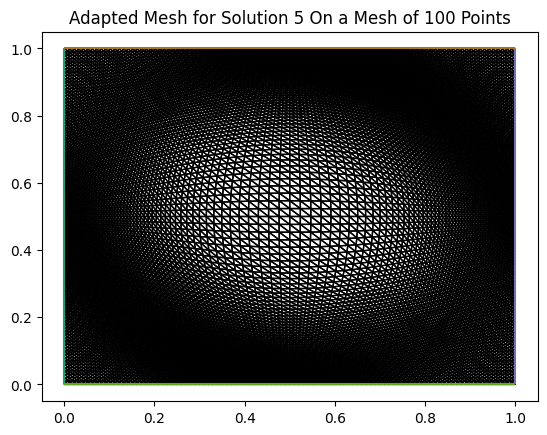



Error for Solution 5  is:  0.014214991835482438



___________________________________________________________________________
PHYSICAL SOLVE 6
___________________________________________________________________________




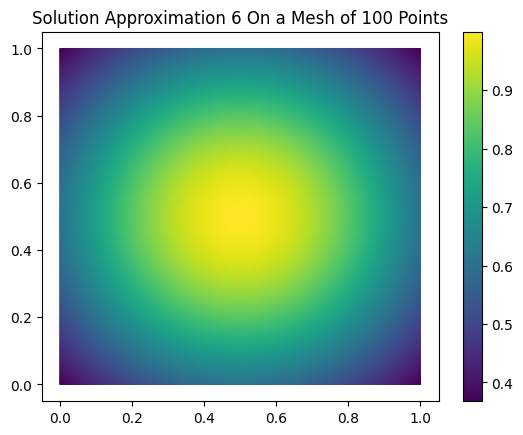





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  6
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




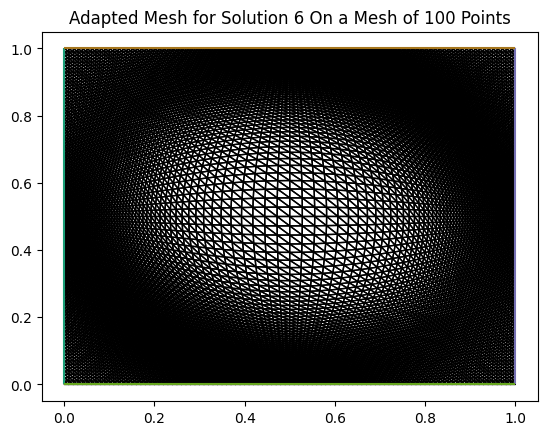



Error for Solution 6  is:  0.014208287324550843



___________________________________________________________________________
PHYSICAL SOLVE 7
___________________________________________________________________________




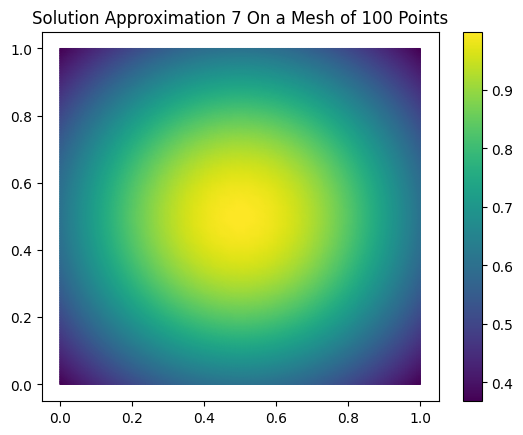





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  7
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




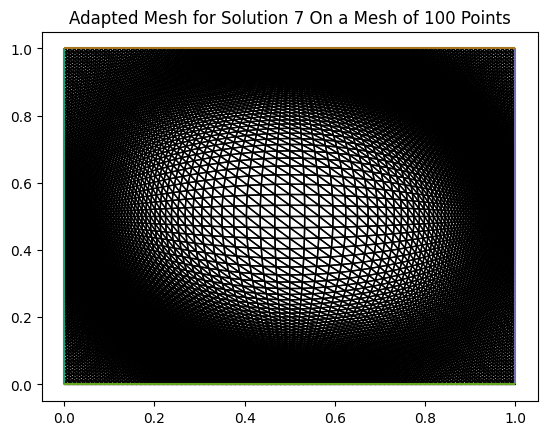



Error for Solution 7  is:  0.01419831927058744



___________________________________________________________________________
PHYSICAL SOLVE 8
___________________________________________________________________________




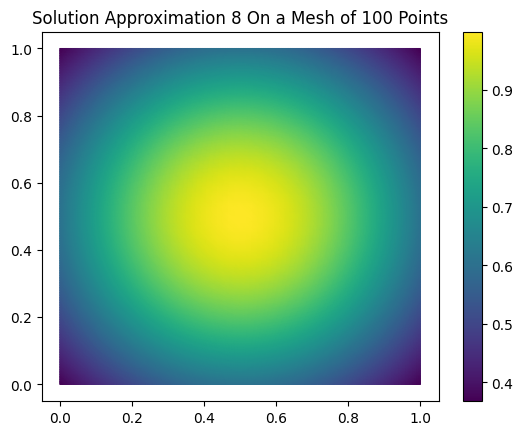





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  8
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




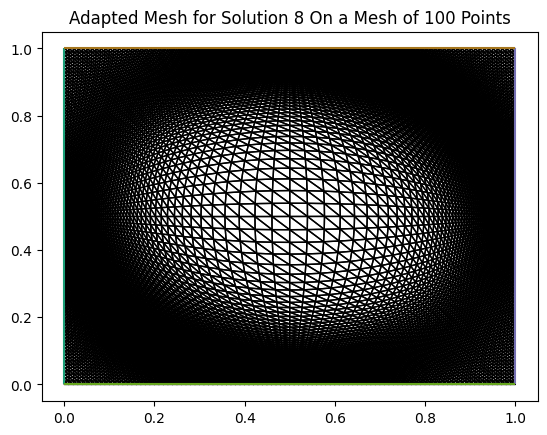



Error for Solution 8  is:  0.014183684540034424



___________________________________________________________________________
PHYSICAL SOLVE 9
___________________________________________________________________________




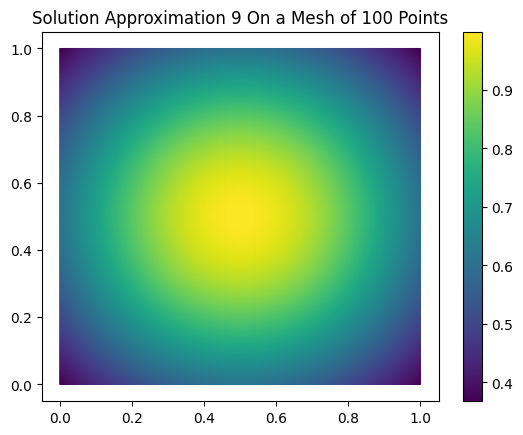





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  9
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




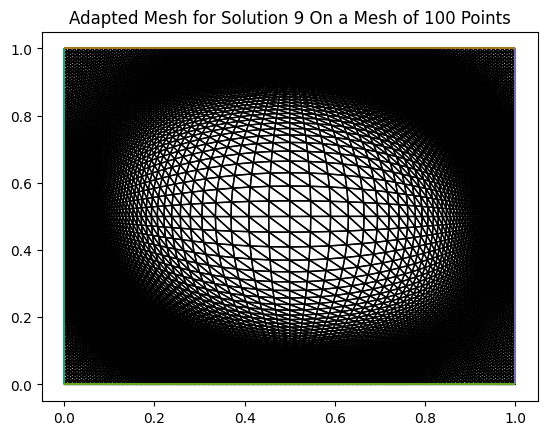



Error for Solution 9  is:  0.01416237222988199



___________________________________________________________________________
PHYSICAL SOLVE 10
___________________________________________________________________________




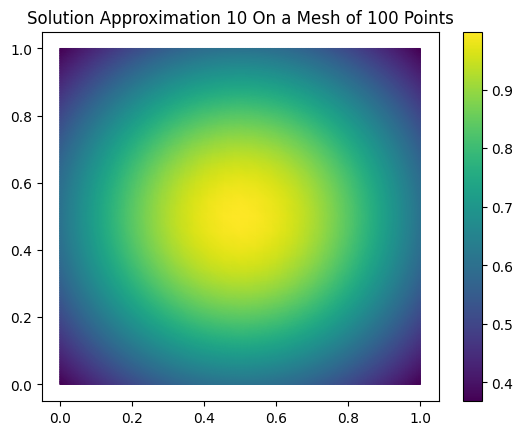





~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
MESH SOLVE  10
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~




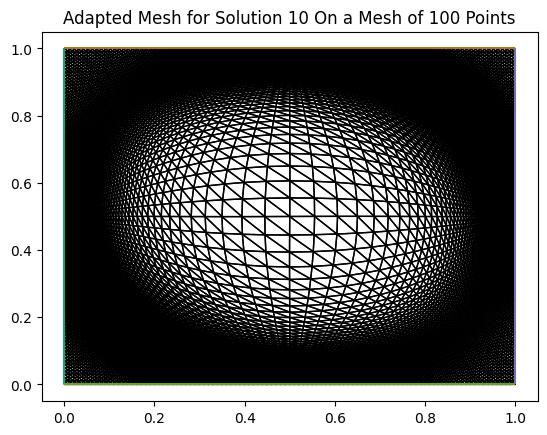



Error for Solution 10  is:  0.014131557162234484



In [ ]:
num_points = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]

errors = []

for val in num_points:

  curr_error = MP_solver(val, 10, sigma = Constant(0.5))

  errors.append(curr_error)



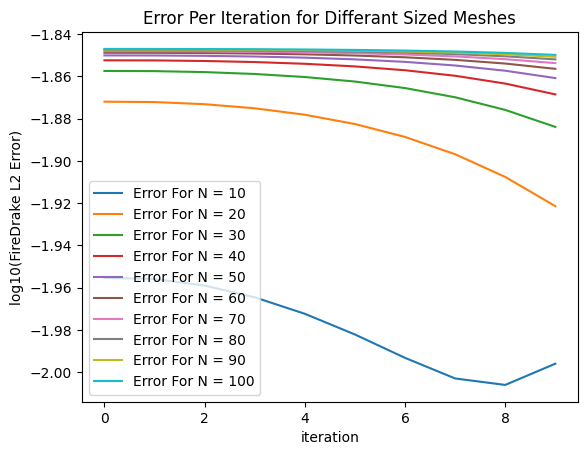

In [ ]:
# plot the errors

for e in range(len(errors)):

  plt.plot([i for i in range(len(errors[e]))], np.log10(errors[e]), label = "Error For N = " + str(num_points[e]))
plt.xlabel('iteration')
plt.ylabel('log10(FireDrake L2 Error)')
plt.title('Error Per Iteration for Differant Sized Meshes')
plt.legend()
plt.show()
